In [1]:
%%html
<!-- add style for an H7 header -->
<style>
  div.H7 { 
    font-size: 0.85em; 
    font-weight: bold;
    font-variant: small-caps; 
    border-style: dotted; 
    border-color: blue; 
    padding: 3px
  }
</style>

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os, sys
import sys

sys.path.append(os.path.realpath('../src/data/'))
from sb_utils import save_file

from pandas_profiling import ProfileReport

<a id='contents'></a>
# Contents
  
* [Project Overview](#overview)  
    * [1.0 AQI](#aqi)
        * [1.0.1 AQI Data Overview](#data_aqi)
            * [1.0.1.1 Import AQI Data](#import_aqi)
            * [1.0.1.2 Audit AQI Data](#audit_aqi)
            * [1.0.1.3 Data Exploration](#profile_aqi)
        * [1.0.2 Save Data](#save_aqi)
        * [1.0.3 AQI Summary](#summary_aqi)
    * [1.1 CDI](#cdi)
        * [1.1.1 CDI Data Overview](#data_cdi)
            * [1.1.1.1 Import AQI Data](#import_cdi)
            * [1.1.1.2 Audit AQI Data](#audit_cdi)
                * [1.1.1.2.1 Dataset Partitioning](#partition_cdi)
                    * [1.1.1.2.1.1 Asthma Topic](#asthma)
                        * [Questions](#questions_asthma)
                        * [StratificationCategory](#stratificationCategory_asthma)
                        * [DataValueUnit](#dataValueUnit_asthma)
                        * [DataValueType](#dataValueType_asthma)
                        * [Year](#year_asthma)
                        * [Summary](#summary_asthma)
                    * [1.1.1.2.1.2 Cancer Topic](#cancer)
                        * [Questions](#questions_cancer)
                        * [StratificationCategory](#stratificationCategory_cancer)
                        * [DataValueUnit](#dataValueUnit_cancer)
                        * [DataValueType](#dataValueType_cancer)
                        * [Year](#year_cancer)
                        * [Summary](#summary_cancer)
                    * [1.1.1.2.1.3 OverarchingConditions Topic](#overarchingConditions)
                    * [1.1.1.2.1.4 COPD Topic](#copd)
                        * [Questions](#questions_copd)
                        * [StratificationCategory](#stratificationCategory_copd)
                        * [DataValueUnit](#dataValueUnit_copd)
                        * [DataValueType](#dataValueType_copd)
                        * [Year](#year_copd)
                        * [Summary](#summary_copd)
                    * [1.1.1.2.1.5 Tobacco Topic](#tobacco)
                * [1.1.1.2.2 Merge Topic Dataframes](#merge_topics) 
        * [1.1.2 Save Data](#save_cdi)
        * [1.1.3 AQI Summary](#summary_cdi)
    * [1.3 Discussion](#discussion)    

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='overview'></a>
# Project Overview
This is the data wrangling notebook for Capstone two. Two data sources are being used for this project:
- [EPA's Air Quality Index (AQI)](#data_aqi)
- [CDC's U.S. Chronic Disease Indicators (CDI)](#data_cdi)

The overall intent of this notebook is to clean data and do some initial data exploration in order to find a way to predict CDI disease outcomes using the AQI data. That is to say, to use Regression on AQI (pollution) features to predict risks of CDI (disease) outcomes. The CDI data will be restricted to respiratory diseases: lung cancers, Chronic Obstructive Pulmonary Disease (COPD), and asthma.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='aqi'></a>
## 1.0 AQI

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='data_aqi'></a>
## 1.0.1 AQI Data



The Air Quality Index (AQI) was developed by the EPA and is used to convey how clean or polluted the air around you is. There are 6 separate AQI levels: Good, Moderate, Unhealthy for Sensitive Groups (USG), Unhealthy, Very Unhealthy, and Hazardous. The thresholds for each category were developed based on established national air quality standards.
<table style="width:100%">
  <th colspan="2" style="text-align:center; background-color:rgba(151, 209, 197, 0.3);">EPA 1980-2021 Yearly Air Quality Index (AQI)</th>
  <tr>
    <th style="text-align:left">Source URL</th>
    <th style="text-align:left">Data Dictionary URL</th>
  </tr>
  <tr>
    <td style="text-align:left"><a href='https://www.kaggle.com/datasets/threnjen/40-years-of-air-quality-index-from-the-epa-yearly'>source</a></td>
    <td style="text-align:left"><a href='https://forum.airnowtech.org/t/aqi-calculations-overview-ozone-pm2-5-and-pm10/168'>data dictionary</a></td>
  </tr>
</table>

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='import_aqi'></a>
### 1.0.1.1 Import AQI Data
Import the raw data from `data > raw` and write it out to the `data > interim directory`. We'll work from the interim folder.

In [3]:
# the supplied CSV data file is the raw_data directory
aqi_df = pd.read_csv('../data/raw/aqi_yearly_1980_to_2021.csv')
aqi_df.shape

(34186, 21)

In [4]:
# save the data to interim dir
datapath = '../data/interim/'
save_file(aqi_df, 'aqi_yearly_1980_to_2021.csv', datapath)
# replace dataframe with interim copy of data
aqi_df = pd.read_csv('../data/raw/aqi_yearly_1980_to_2021.csv')

A file already exists with this name.

Do you want to overwrite? (Y/N)Y
Writing file.  "../data/interim/aqi_yearly_1980_to_2021.csv"


<a href='#contents' style="float: right;">[back to toc]</a>
<a id='audit_aqi'></a>
### 1.0.1.2 Audit Data

As a first step, lets look at a sample of data

In [5]:
aqi_df.sample(10)

,State,County,Year,Days with AQI,Good Days,Moderate Days,Unhealthy for Sensitive Groups Days,Unhealthy Days,Very Unhealthy Days,Hazardous Days,...,90th Percentile AQI,Median AQI,Days CO,Days NO2,Days Ozone,Days SO2,Days PM2.5,Days PM10,Latitude,Longitude
28113,Arkansas,Arkansas,2015,116,88,28,0,0,0,0,...,58,34,0,0,0,0,116,0,34.518515,-91.558960
28443,Louisiana,St. Martin,2015,65,59,6,0,0,0,0,...,50,38,0,0,65,0,0,0,30.088872,-91.869595
995,Texas,Brazoria,1980,266,220,33,10,2,1,0,...,74,34,0,92,164,10,0,0,29.043759,-95.472946
12437,Missouri,Monroe,1998,363,275,75,12,1,0,0,...,84,34,0,0,211,135,0,17,39.474976,-91.788991
20275,Alabama,Montgomery,2007,353,157,177,14,5,0,0,...,87,53,0,0,123,0,230,0,32.412811,-86.263394
23084,Virginia,Virginia Beach City,2009,348,261,87,0,0,0,0,...,59,34,0,0,0,1,347,0,36.841883,-76.181233
12477,New Jersey,Essex,1998,365,176,169,16,4,0,0,...,89,51,0,269,65,28,0,3,40.720989,-74.192892
18131,South Carolina,Florence,2004,112,56,56,0,0,0,0,...,69,51,0,0,0,0,112,0,34.167500,-79.562660
19603,Kansas,Ford,2006,23,21,2,0,0,0,0,...,34,18,0,0,0,0,0,23,37.775303,-100.035440
9979,Michigan,Huron,1995,177,131,34,11,0,1,0,...,93,39,0,0,177,0,0,0,43.836388,-82.642900


The 'Days with AQI' column looks like it should always be the sum of its component columns:
'Good Days','Moderate Days','Unhealthy for Sensitive Groups Days','Unhealthy Days','Very Unhealthy Days','Hazardous Days'.
Lets make sure that this is true:

In [6]:
# tests that the sum of the day measures of each observation ('Good Days','Moderate Days',
#'Unhealthy for Sensitive Groups Days','Unhealthy Days','Very Unhealthy Days',
#'Hazardous Days') equals the 'Days with AQI' value
def test_categorized_days(row_idx=0):
    '''expects the row index to check. Returns True if 'Days with AQI' equals sum of other measures'''
    days_with_aqi = aqi_df.iloc[row_idx]['Days with AQI']
    sum_all_days = aqi_df.iloc[row_idx]['Good Days'] + aqi_df.iloc[row_idx]['Moderate Days'] + aqi_df.iloc[row_idx]['Unhealthy for Sensitive Groups Days'] + aqi_df.iloc[row_idx]['Unhealthy Days']+ aqi_df.iloc[row_idx]['Very Unhealthy Days'] + aqi_df.iloc[row_idx]['Hazardous Days']
    assert days_with_aqi == sum_all_days, "{} measures do not sum ({}) to Days with AQI ({})".format(aqi_df.iloc[row_idx]['State'],sum_all_days,days_with_aqi)
    
for row in range(aqi_df.shape[0]):
    test_categorized_days(row)

That confirms that 'Days with AQI' is the sum of the columns given above. Columns 'Days CO','Days NO2','Days Ozone','Days SO2','Days PM2.5','Days PM10' look to also sum to 'Days with AQI':

In [7]:
# tests that the sum of the day measures of each observation ('Days CO','Days NO2',
# 'Days Ozone','Days SO2','Days PM2.5','Days PM10') equals the 'Days with AQI' value
def test_measured_days(row_idx=0):
    '''expects the row index to check. Returns True if 'Days with AQI' equals sum of other measures'''
    days_with_aqi = aqi_df.iloc[row_idx]['Days with AQI']
    sum_all_days = aqi_df.iloc[row_idx]['Days CO'] + aqi_df.iloc[row_idx]['Days NO2'] + aqi_df.iloc[row_idx]['Days Ozone'] + aqi_df.iloc[row_idx]['Days SO2']+ aqi_df.iloc[row_idx]['Days PM2.5'] + aqi_df.iloc[row_idx]['Days PM10']
    assert days_with_aqi == sum_all_days, "{} measures do not sum ({}) to Days with AQI ({})".format(aqi_df.iloc[row_idx]['State'],sum_all_days,days_with_aqi)

for row in range(aqi_df.shape[0]):
    test_measured_days(row)

That confirms that 'Days with AQI' is the sum of these columns as well.

Lets take a look at the monitored states:

In [8]:
aqi_df['State'].unique()

array(['Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California',
       'Colorado', 'Connecticut', 'Country Of Mexico', 'Florida',
       'Georgia', 'Hawaii', 'Idaho', 'Illinois', 'Indiana', 'Iowa',
       'Kentucky', 'Louisiana', 'Maine', 'Maryland', 'Massachusetts',
       'Michigan', 'Minnesota', 'Mississippi', 'Missouri', 'Montana',
       'Nebraska', 'Nevada', 'New Hampshire', 'New Jersey', 'New Mexico',
       'New York', 'North Carolina', 'North Dakota', 'Ohio', 'Oklahoma',
       'Oregon', 'Pennsylvania', 'Rhode Island', 'South Carolina',
       'Tennessee', 'Texas', 'Utah', 'Virginia', 'Washington',
       'West Virginia', 'Wisconsin', 'Wyoming', 'Delaware',
       'District Of Columbia', 'Kansas', 'Puerto Rico', 'Vermont',
       'Virgin Islands', 'South Dakota'], dtype=object)

So this dataset includes three countries that are either not part of the US or is a commonwealth territory:
'Country Of Mexico', 'Puerto Rico', and 'Virgin Islands'.
Lets remove those and concentrate on US states:

In [9]:
aqi_df = aqi_df[~aqi_df['State'].isin(['Country Of Mexico','Puerto Rico','Virgin Islands'])]
aqi_df['State'].unique()

array(['Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California',
       'Colorado', 'Connecticut', 'Florida', 'Georgia', 'Hawaii', 'Idaho',
       'Illinois', 'Indiana', 'Iowa', 'Kentucky', 'Louisiana', 'Maine',
       'Maryland', 'Massachusetts', 'Michigan', 'Minnesota',
       'Mississippi', 'Missouri', 'Montana', 'Nebraska', 'Nevada',
       'New Hampshire', 'New Jersey', 'New Mexico', 'New York',
       'North Carolina', 'North Dakota', 'Ohio', 'Oklahoma', 'Oregon',
       'Pennsylvania', 'Rhode Island', 'South Carolina', 'Tennessee',
       'Texas', 'Utah', 'Virginia', 'Washington', 'West Virginia',
       'Wisconsin', 'Wyoming', 'Delaware', 'District Of Columbia',
       'Kansas', 'Vermont', 'South Dakota'], dtype=object)

Lets look at the average of days measured by year

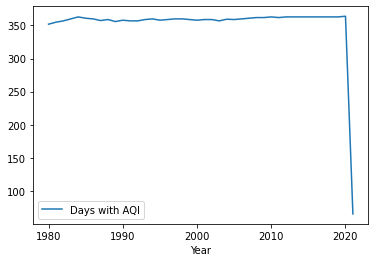

In [10]:
# avg all Days with AQI by year
measures = aqi_df[['Year','Days with AQI']].groupby('Year').median()
measures.plot();

So, it seems like 2021 is either a partial year of data or radically different number of AQI readings, for some reason (perhaps changes in the way that the EPA measures). Regardless, its highly anomolous so I'm excluding it.

In [11]:
# toss out 2021
print('shape before is {}'.format(aqi_df.shape))
aqi_df = aqi_df.query('Year != 2021')
print('shape after is {}'.format(aqi_df.shape))

shape before is (33750, 21)
shape after is (33153, 21)


Following is the pandas-profiling report and an exploration of its warnings.

In [12]:
profile = ProfileReport(aqi_df, title="Pandas Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/36 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: State has high cardinality</span>

In [13]:
aqi_df['State'].unique()

array(['Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California',
       'Colorado', 'Connecticut', 'Delaware', 'District Of Columbia',
       'Florida', 'Georgia', 'Hawaii', 'Idaho', 'Illinois', 'Indiana',
       'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Maine', 'Maryland',
       'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi',
       'Missouri', 'Montana', 'Nebraska', 'Nevada', 'New Hampshire',
       'New Jersey', 'New Mexico', 'New York', 'North Carolina',
       'North Dakota', 'Ohio', 'Oklahoma', 'Oregon', 'Pennsylvania',
       'Rhode Island', 'South Carolina', 'Tennessee', 'Texas', 'Utah',
       'Vermont', 'Virginia', 'Washington', 'West Virginia', 'Wisconsin',
       'Wyoming', 'South Dakota'], dtype=object)

The data contains 54 distinct values; all 50 states plus Puerto Rico, Virgin Islands, and District of Columbia and (for some reason), the country of Mexico.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: County has a high cardinality: 791 distinct values</span>

In [14]:
len(aqi_df['County'].unique())

791

This column looks fine. The 791 values appear to be distinct without using the state column.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Max AQI is highly skewed (γ1 = 47.79861548)</span>

Plot along log y scale to see the shape:

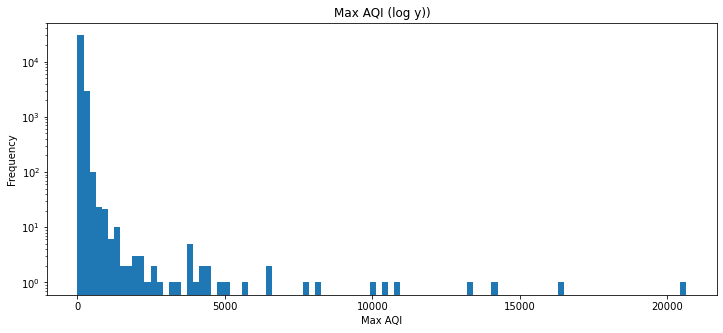

In [15]:
(aqi_df['Max AQI']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(12, 5), title='Max AQI (log y))'))
plt.xlabel('Max AQI');

So it appears that the data has a long tail (skewed left). This seems reasonable since we would expect to see lower scores at the national level.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Moderate Days has 1057 (3.2%) zeros</span>

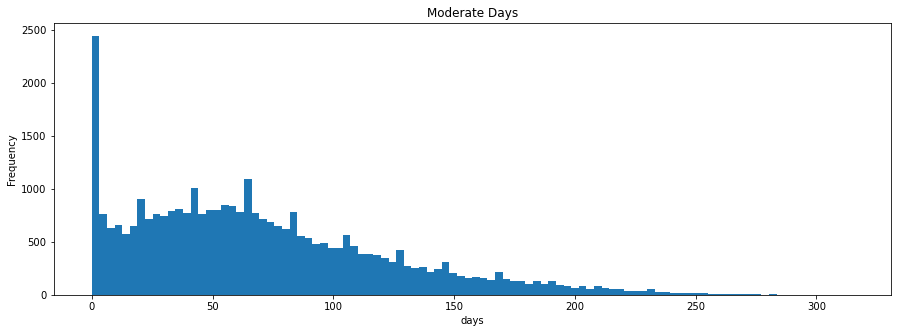

In [16]:
(aqi_df['Moderate Days']
    .sort_values(ascending=False)
    .plot(kind='hist', bins=100, figsize=(15, 5), title='Moderate Days'))
plt.xlabel('days');

Once again, the distribution skews left. The shape is somewhat normally distributed, but with many days assuming the value of zero. This makes some sense, as we would expect modirate scores to represent average pollution levels.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Unhealthy for Sensitive Groups Days has 8834 (26.6%) zeros</span>

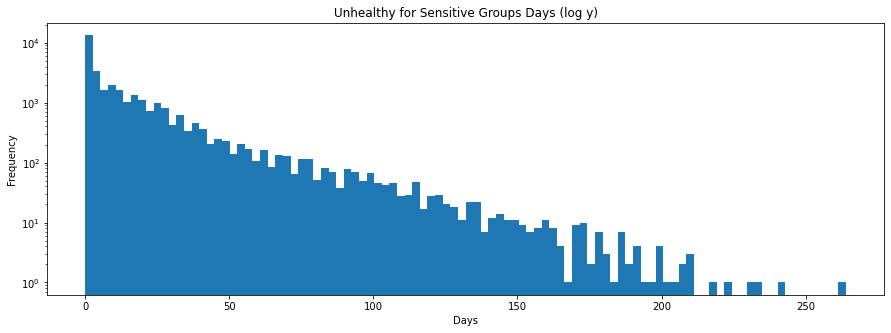

In [17]:
(aqi_df['Unhealthy for Sensitive Groups Days']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Unhealthy for Sensitive Groups Days (log y)'))
plt.xlabel('Days');

Interestingly, the data looks linear (monotonically decreasing). This might suggest that this category has relatively constant scoring across time.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Unhealthy Days has 18615 (56.1%) zeros</span>

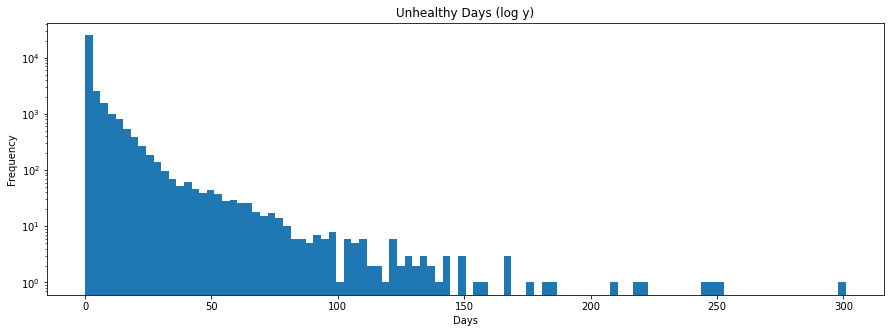

In [18]:
(aqi_df['Unhealthy Days']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Unhealthy Days (log y)'))
plt.xlabel('Days');

The data has a similar profile to 'Unhealthy for Sensitive Groups Days', but more of a pronounced tail. 

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Very Unhealthy Days has 28715 (86.6%) zeros</span>

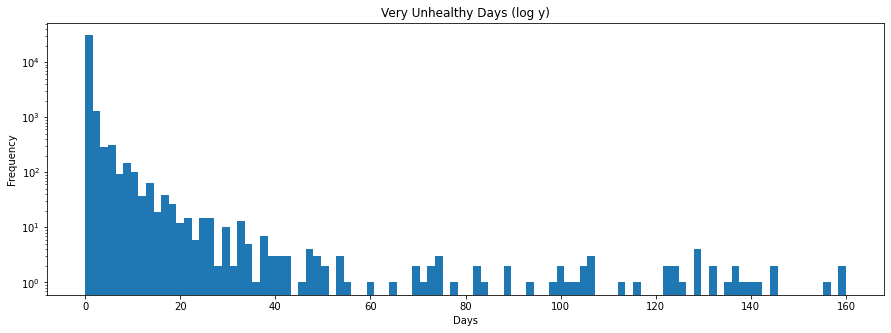

In [19]:
(aqi_df['Very Unhealthy Days']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Very Unhealthy Days (log y)'))
plt.xlabel('Days');

The data has a similar profile to 'Unhealthy Days', but more with more variability in its tail.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Hazardous Days has 32855 (99.1%) zeros</span> \
<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Hazardous Days is highly skewed (γ1 = 32.32756313)</span>

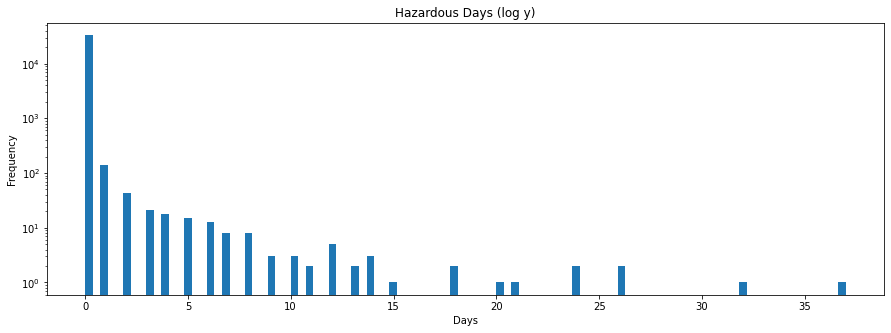

In [20]:
(aqi_df['Hazardous Days']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Hazardous Days (log y)'))
plt.xlabel('Days');

This data is sparsly scored, but this is the most extreme score and we'd expect infrequent counting, so no adjustment is being considered. 

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Days CO has 27405 (82.7%) zeros</span>

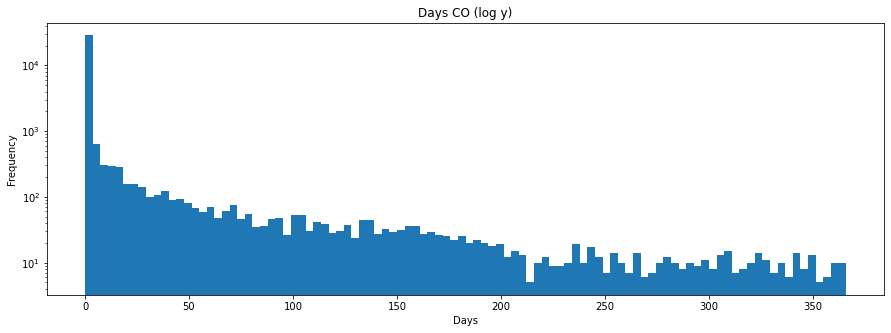

In [21]:
(aqi_df['Days CO']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Days CO (log y)'))
plt.xlabel('Days');

The data is monotonically decreasing on average, with the majority of days scoring zero.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Days NO2 has 25057 (75.6%) zeros</span>

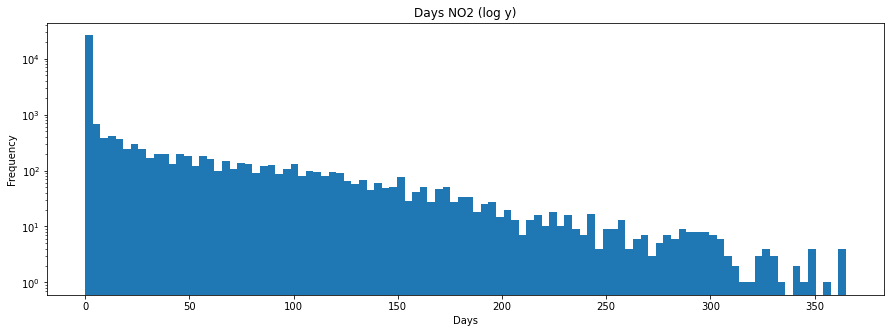

In [22]:
(aqi_df['Days NO2']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Days NO2 (log y)'))
plt.xlabel('Days');

The data is monotonically decreasing on average, with the majority of days scoring zero.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Days Ozone has 8833 (26.6%) zeros</span>

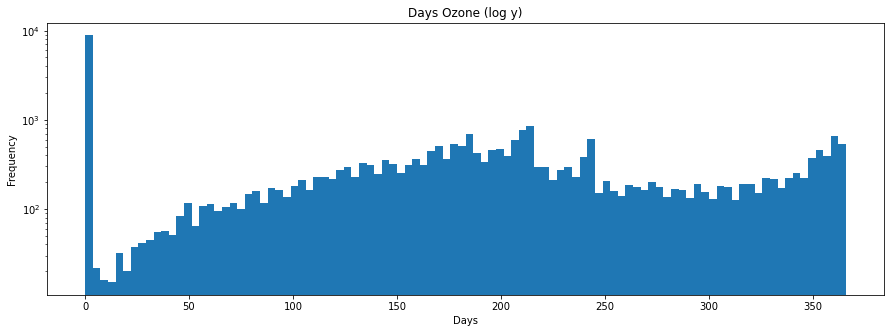

In [23]:
(aqi_df['Days Ozone']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Days Ozone (log y)'))
plt.xlabel('Days');

The distribution has extremes at the left and right tail. We've seen many of the distributions  heavily scored as zero. But this has a somewhat normal distribution except for the rise in the right tail. A component of that might be the binning of 365 and 366 day years together. But the increase starts somewhere after 300 days, so this can't explain all of it.

Let's plot Ozone measures by state to see if we can see a pattern towards the right tail.

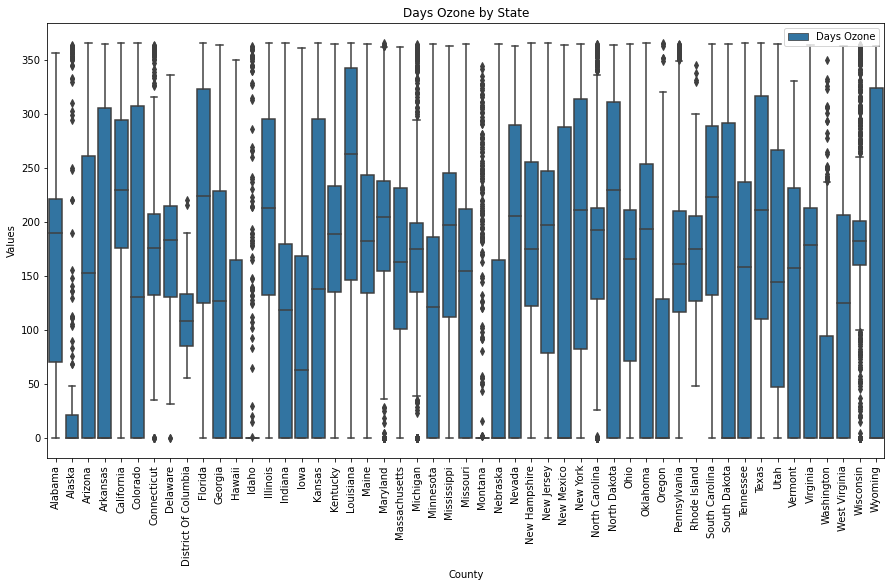

In [24]:
# melt to give us State vs value
temp = pd.melt(aqi_df[['State', 'Days Ozone']],
                        id_vars='State', 
                        var_name='Measures', 
                        value_vars=['Days Ozone'],
                        value_name='Target')

plt.subplots(figsize=(15, 8))
sns.boxplot(x='State', y='Target', hue='Measures', data=temp.sort_values('State'))
plt.xticks(rotation='vertical')
plt.ylabel('Values')
plt.xlabel('County')
plt.title('Days Ozone by State')
plt.legend(loc='upper right');

It looks like there is a pile up of extreme values towards the right tail. Also, the IQR is wide in states that have many days with no ozone, reflecting the shallow curve in the histogram of ozone scores. However, there are states such as Colorado that have tight IQR distributions, suggesting that Ozone levels are confined to a tight range.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Days SO2 has 22586 (68.1%) zeros</span>

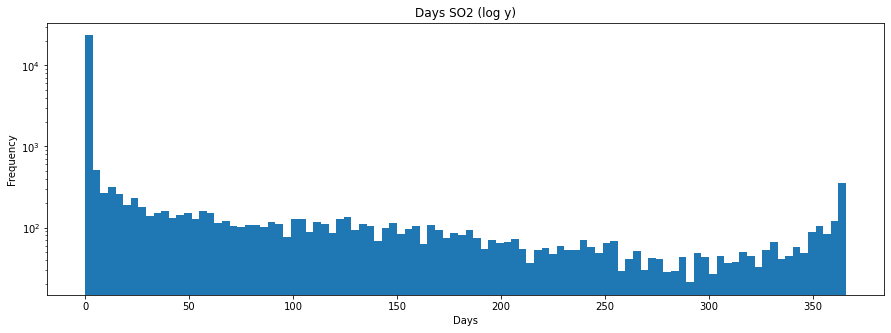

In [25]:
(aqi_df['Days SO2']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Days SO2 (log y)'))
plt.xlabel('Days');

Once again, lets look at the increase in the right tail.

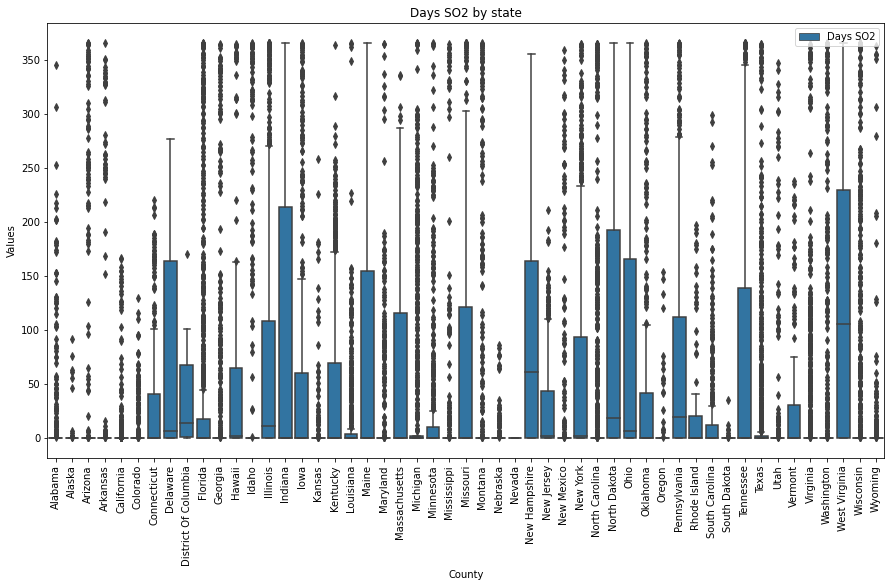

In [26]:
# melt to give us State vs value
temp = pd.melt(aqi_df[['State', 'Days SO2']],
                        id_vars='State', 
                        var_name='Measures', 
                        value_vars=['Days SO2'],
                        value_name='Target')

plt.subplots(figsize=(15, 8))
sns.boxplot(x='State', y='Target', hue='Measures', data=temp.sort_values('State'))
plt.xticks(rotation='vertical')
plt.ylabel('Values')
plt.xlabel('County')
plt.title('Days SO2 by state')
plt.legend(loc='upper right');

Again, this seems to be caused by extreme values toward the right.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Days PM2.5 has 17016 (51.3%) zeros</span>

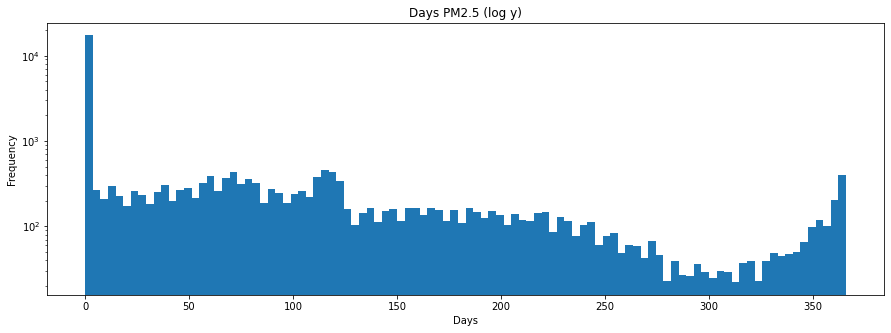

In [27]:
(aqi_df['Days PM2.5']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Days PM2.5 (log y)'))
plt.xlabel('Days');

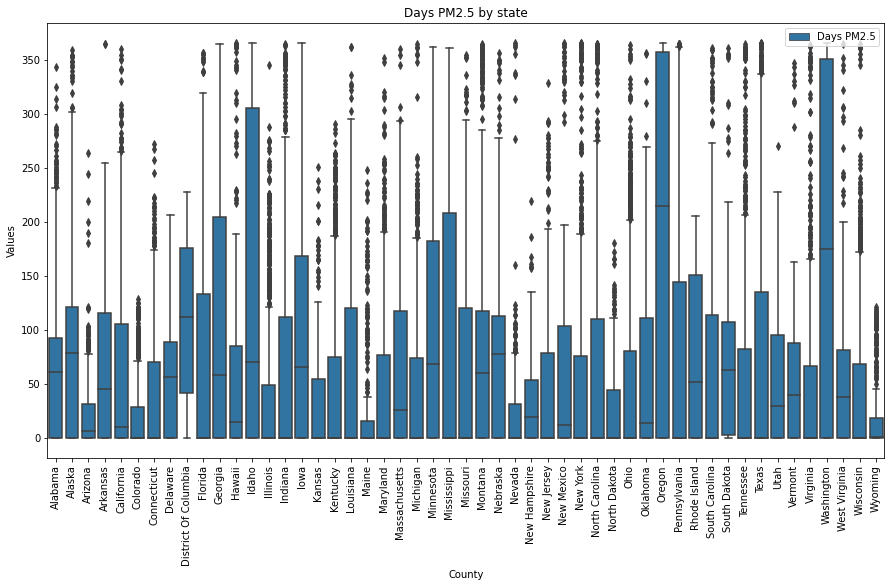

In [28]:
# melt to give us State vs Days Ozone
temp = pd.melt(aqi_df[['State', 'Days PM2.5']],
                        id_vars='State', 
                        var_name='Measures', 
                        value_vars=['Days PM2.5'],
                        value_name='Target')

plt.subplots(figsize=(15, 8))
sns.boxplot(x='State', y='Target', hue='Measures', data=temp.sort_values('State'))
plt.xticks(rotation='vertical')
plt.ylabel('Values')
plt.xlabel('County')
plt.title('Days PM2.5 by state')
plt.legend(loc='upper right');

This time, the IQR of three states stretch into the right tail. This plus extreme values is responsible for the upward curve of the right tail.

<span style="background-color:rgba(255, 0, 0, 0.2);">Warning: Days PM10 has 20733 (62.5%) zeros</span>

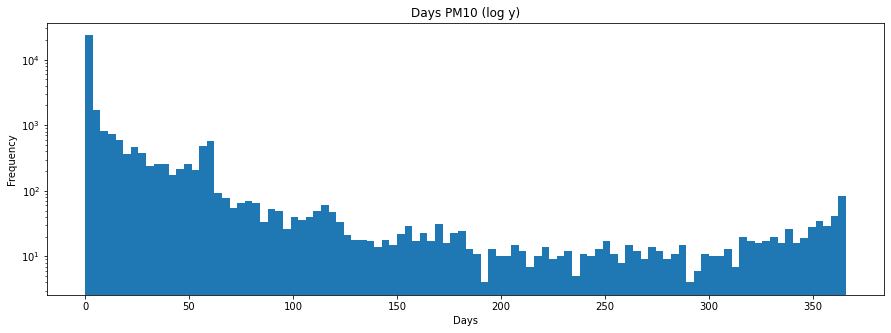

In [29]:
(aqi_df['Days PM10']
    .sort_values(ascending=False)
    .plot(kind='hist', logy=True, bins=100, figsize=(15, 5), title='Days PM10 (log y)'))
plt.xlabel('Days');

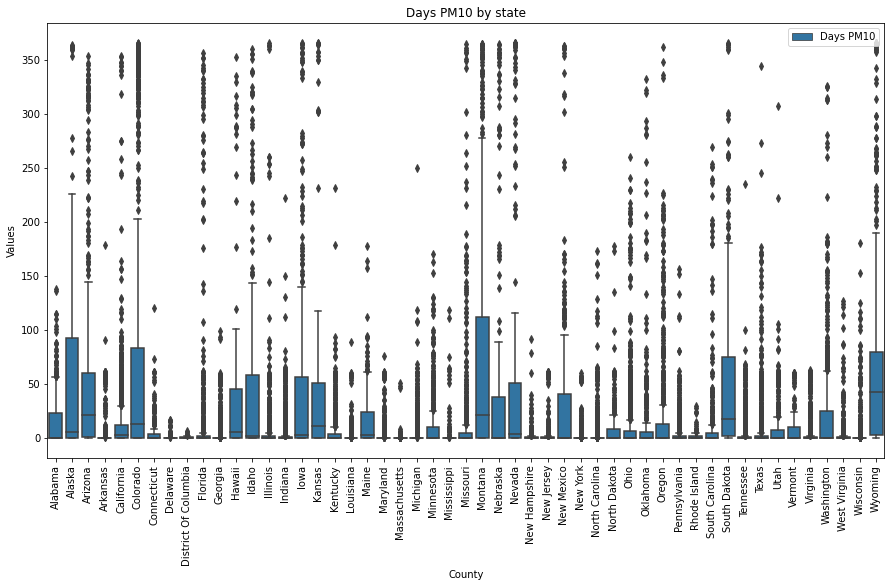

In [30]:
# melt to give us State vs Days Ozone
temp = pd.melt(aqi_df[['State', 'Days PM10']],
                        id_vars='State', 
                        var_name='Measures', 
                        value_vars=['Days PM10'],
                        value_name='Target')

plt.subplots(figsize=(15, 8))
sns.boxplot(x='State', y='Target', hue='Measures', data=temp.sort_values('State'))
plt.xticks(rotation='vertical')
plt.ylabel('Values')
plt.xlabel('County')
plt.title('Days PM10 by state')
plt.legend(loc='upper right');

PM10 levels have consistently low median values, but plenty of extreme values to push the uptick in the right tail.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='profile_aqi'></a>
### 1.0.1.3 Data Exploration

Lets get an overview of the data over the values 'Good Days', 'Moderate Days', 'Unhealthy for Sensitive Groups Days', 'Unhealthy Days', 'Very Unhealthy Days', 'Hazardous Days' over their associated geocoordinates.

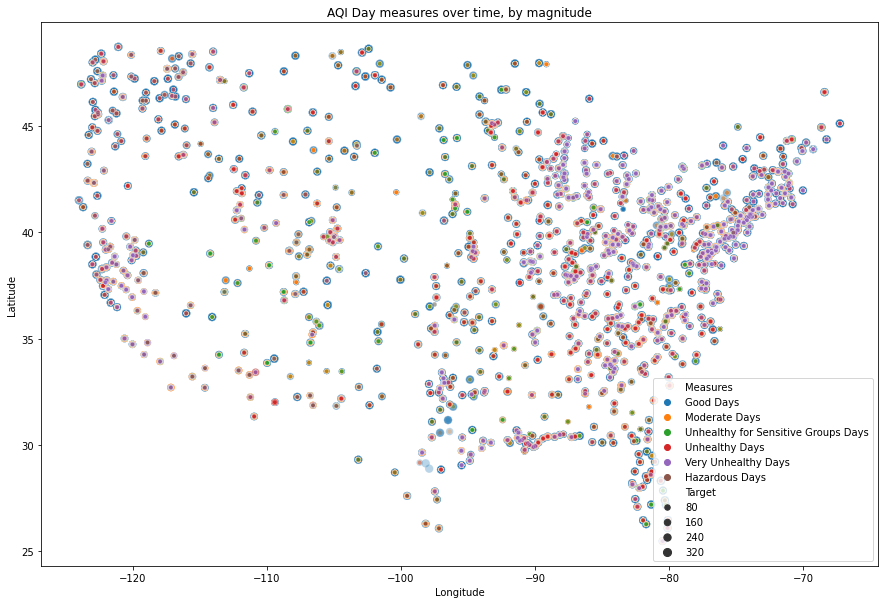

In [31]:
# Input is one of: Good Days, Moderate Days, Unhealthy for Sensitive Groups Days, Unhealthy Days, Very Unhealthy Days, Hazardous Days
def get_color_code(day_cat):
    '''return a color for the given category'''
    if day_cat == 'Good Days':
        return 'green'
    elif day_cat == 'Moderate Days':
        return 'blue'
    elif day_cat == 'Unhealthy for Sensitive Groups Days':
        return 'yellow'
    elif day_cat == 'Unhealthy Days':
        return 'pink'
    elif day_cat == 'Very Unhealthy Days':
        return 'orange'
    elif day_cat == 'Hazardous Days':
        return 'red'
    return
    
temp = pd.melt(aqi_df[['State', 'Good Days', 'Moderate Days', 'Unhealthy for Sensitive Groups Days', 'Unhealthy Days', 'Very Unhealthy Days', 'Hazardous Days', 'Latitude', 'Longitude']],
                        id_vars=['State','Latitude','Longitude'], 
                        var_name='Measures', 
                        value_vars=['Good Days', 'Moderate Days', 'Unhealthy for Sensitive Groups Days', 'Unhealthy Days', 'Very Unhealthy Days', 'Hazardous Days'],
                        value_name='Target')

# add a color column
temp['Color'] = np.nan
# drop rows where value is zero (otherwise we plot points for every value)
temp.drop(temp[temp['Target'] == 0].index, inplace=True)

# map the color code for the day category
temp.iloc[:,5] = temp.iloc[:,3].apply(lambda x: get_color_code(x))

# confine the plot to continental US
temp.drop(temp[temp['Longitude'] < -125].index, inplace=True)

# now plot
fig, ax = plt.subplots(figsize=(15, 10))
labels = temp['Measures'].unique()
sns.scatterplot(x=temp['Longitude'],y=temp['Latitude'], alpha=0.3, hue=temp['Measures'], size=temp.Target).set(title="AQI Day measures over time, by magnitude")
plt.legend(loc='lower right');


That's enough coverage to make out the shape of the continental USA! This gives a feeling for state of air pollution over the last twenty or so years.

Lets see what 'Days with AQI' (literally the amount of days that data was collected - with no connotation of what category that data will be put into) data collection looks like at the state level:

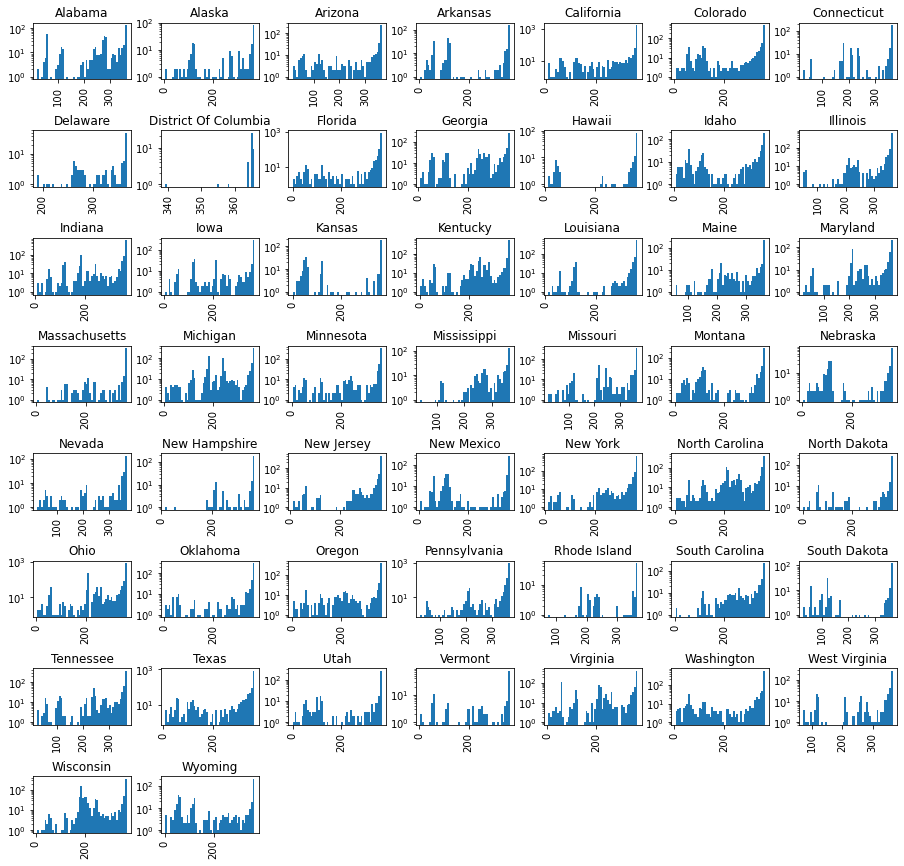

In [110]:
aqi_df.hist(log=True,by=['State'],column='Days with AQI',figsize=(15, 15),bins=50)
plt.subplots_adjust(hspace=0.9);

It looks as if days with AQI is clustered around whole numbers, particularly around 50, 100, 200, and 365-6 (the year is alternately recorded as 366 days, presumably to catch measures carried over by the previous year). But let's look at the clustering more closely. Arizona seems indicative of this behavior, so let's look at it at the county level.

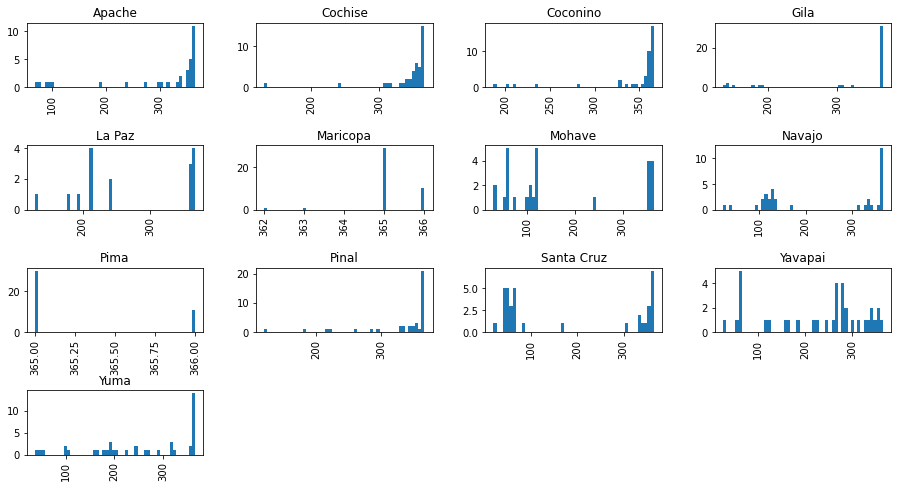

In [33]:
aqi_df[aqi_df['State'] == 'Arizona'].hist(by=['County'],column='Days with AQI',figsize=(15, 8),bins=50)
plt.subplots_adjust(hspace=0.9);

The pattern seems less discernable at the county level. More variance can be seen. Perhaps any patterns seen are an artifact of binning by the histogram algorithm. Alternatively, there may be seasonal patterns at play, where pollution measures are tied to weather patterns.  

Following is a look at Arizona's counties by year, so that we can get time progression view.

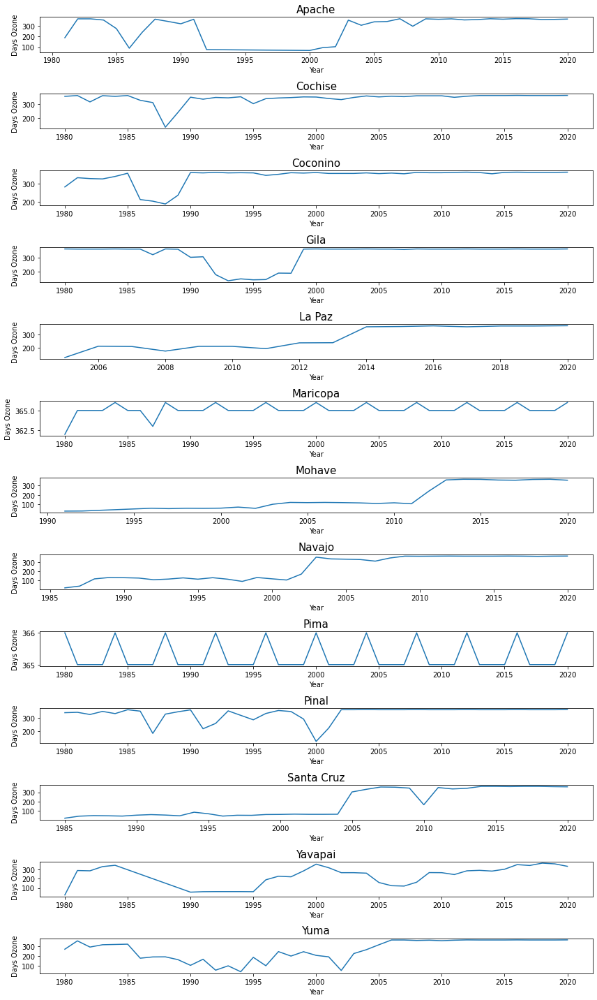

In [34]:
counties = aqi_df[aqi_df['State'] == 'Arizona']['County'].sort_values().unique().tolist()
cali = aqi_df[aqi_df['State'] == 'Arizona']
fig, ax = plt.subplots(nrows=len(counties), figsize=(12,20))

for i,c in enumerate(counties):
    filt = cali['County'] == c
    ax[i].plot(cali.loc[filt]['Year'],cali.loc[filt]['Days with AQI']) 
    ax[i].set_title(c, size=15)
    ax[i].set_xlabel('Year', size=10)
    ax[i].set_ylabel('Days Ozone', size=10)

plt.tight_layout()

Well, Days with AQI clearly ramps toward daily scoring over time. But their are curious variabilities in the first halves of may county scores. Cochise and Coconino have major dips in daily AQI between 1985-1990. Gila between ~1990-1998. Apache county has both dips. Pinal has those too plus one around 2000. Yavapai and Yuma have one sustained dip between ~1985-2000. The "sawtooth" pattern of counties like Pima is actually just oscillation between how the EPA counts alternating years, either 365 or 366.

Lets look at California since its clean air regulations are usually more progressive than the EPA's. 

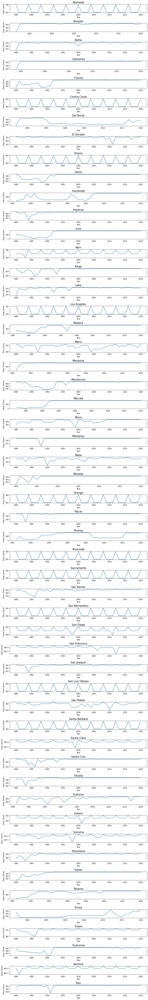

In [35]:
counties = aqi_df[aqi_df['State'] == 'California']['County'].sort_values().unique().tolist()
cali = aqi_df[aqi_df['State'] == 'California']
fig, ax = plt.subplots(nrows=len(counties), figsize=(12,80))

for i,c in enumerate(counties):
    filt = cali['County'] == c
    ax[i].plot(cali.loc[filt]['Year'],cali.loc[filt]['Days with AQI']) 
    ax[i].set_title(c, size=15)
    ax[i].set_xlabel('Year', size=10)
    ax[i].set_ylabel('Days Ozone', size=10)

plt.tight_layout()

Some of these same variabilities occur in California as well. I'd hypothesize that there is a systematic change in the way EPA collected or scored data during certain periods. 

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='save_aqi'></a>
### 1.0.2 Save data

In [36]:
# save the data to interim dir
datapath = '../data/interim/'
save_file(aqi_df, 'aqi_yearly_1980_to_2021.csv', datapath)

A file already exists with this name.

Do you want to overwrite? (Y/N)y
Writing file.  "../data/interim/aqi_yearly_1980_to_2021.csv"


<a href='#contents' style="float: right;">[back to toc]</a>
<a id='summary_aqi'></a>
### 1.0.3 AQI Summary

Summary of the AQI data:
- days measures are classifictions - they sum to the 'AQI Days' measure
- measures were restricted to US States
- we removed (incomplete) 2021 data
- AQI day measures were taken inconsistently over time. But this may not prove to be a barrier since we are using measures over time

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='cdi'></a>
## 1.1 CDI

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='data_cdi'></a>
### 1.1.1 CDI Data Overview
The U.S. Chronic Disease Indicators (CDI) are a set of indicators provided by CDC that allows states and territories and large metropolitan areas to uniformly define, collect, and report chronic disease data that are important to public health practice and available for states, territories and large metropolitan areas.
<table style="width:100%">
  <th colspan="3" style="text-align:center; background-color:rgba(151, 209, 197, 0.3);">U.S. Chronic Disease Indicators (CDI)</th>
  <tr>
    <th style="text-align:left">Source URL</th>
    <th style="text-align:left">Exploration URL</th>
    <th style="text-align:left">Data Dictionary URL</th>
  </tr>
  <tr>
    <td style="text-align:left"><a href='https://healthdata.gov/dataset/U-S-Chronic-Disease-Indicators-CDI-/67sp-6x8j'>source</a></td>
    <td style="text-align:left"><a href='https://nccd.cdc.gov/cdi/rdPage.aspx?rdReport=DPH_CDI.ExploreByTopic&islTopic=AST&islYear=9999&go=GO'>explore</a></td>
    <td style="text-align:left"><a href='https://www.cdc.gov/cdi/definitions/cancer.html#CAN8_1'>data dictionary</a></td>
  </tr>
</table>

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='import_cdi'></a>
#### 1.1.1.1 Import CDI Data
Import the raw data from data > raw and write it out to the data > interim directory. We'll work from the interim folder.

In [37]:
# the supplied CSV data file is the raw_data directory
cdi_df = pd.read_csv('../data/raw/U.S._Chronic_Disease_Indicators__CDI_.csv')
cdi_df.shape

/var/folders/cb/c8ztm6y15njfh93260_j14j80000gn/T/ipykernel_4618/3307417281.py:2: DtypeWarning: Columns (10) have mixed types. Specify dtype option on import or set low_memory=False.
  cdi_df = pd.read_csv('../data/raw/U.S._Chronic_Disease_Indicators__CDI_.csv')


(1082328, 34)

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='audit_cdi'></a>
#### 1.1.1.2 Audit CDI Data

In [38]:
cdi_df.sample(10)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,Response,DataValueUnit,DataValueType,...,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1,StratificationCategoryID2,StratificationID2,StratificationCategoryID3,StratificationID3
430538,2009,2013,OR,Oregon,Death Certificate,Cancer,"Cancer of the female cervix, mortality",NaN,"per 100,000",Average Annual Crude Rate,...,41,CAN,CAN6_2,AVGANNCRDRATE,RACE,BLK,NaN,NaN,NaN,NaN
460861,2018,2018,TX,Texas,NVSS,Asthma,Asthma mortality rate,NaN,Number,Number,...,48,AST,AST4_1,NMBR,RACE,BLK,NaN,NaN,NaN,NaN
913941,2013,2013,SC,South Carolina,BRFSS,Diabetes,Pneumococcal vaccination among noninstitutiona...,NaN,%,Crude Prevalence,...,45,DIA,DIA13_1,CRDPREV,GENDER,GENF,NaN,NaN,NaN,NaN
339795,2008,2012,IN,Indiana,Death Certificate,Cancer,"Cancer of the colon and rectum (colorectal), m...",NaN,"per 100,000",Average Annual Age-adjusted Rate,...,18,CAN,CAN7_2,AVGANNAGEADJRATE,RACE,APIO,NaN,NaN,NaN,NaN
378090,2012,2016,MT,Montana,Statewide central cancer registries,Cancer,"Cancer of the colon and rectum (colorectal), i...",NaN,"per 100,000",Average Annual Age-adjusted Rate,...,30,CAN,CAN7_1,AVGANNAGEADJRATE,RACE,APIO,NaN,NaN,NaN,NaN
198594,2017,2017,OH,Ohio,APIS,Alcohol,Amount of alcohol excise tax by beverage type ...,NaN,$,US Dollars,...,39,ALC,ALC8_0_2,USD,OVERALL,OVR,NaN,NaN,NaN,NaN
927685,2011,2011,TN,Tennessee,BRFSS,Arthritis,Arthritis among adults aged >= 18 years,NaN,%,Age-adjusted Prevalence,...,47,ART,ART1_1,AGEADJPREV,RACE,OTH,NaN,NaN,NaN,NaN
277616,2018,2018,WI,Wisconsin,CMS Part A Claims Data,Cardiovascular Disease,Hospitalization for heart failure among Medica...,NaN,"cases per 1,000",Crude Rate,...,55,CVD,CVD2_0,CRDRATE,RACE,HIS,NaN,NaN,NaN,NaN
958776,2013,2013,VI,Virgin Islands,BRFSS,Cardiovascular Disease,Cholesterol screening among adults aged >= 18 ...,NaN,%,Crude Prevalence,...,78,CVD,CVD4_0,CRDPREV,RACE,BLK,NaN,NaN,NaN,NaN
776778,2017,2017,NC,North Carolina,BRFSS,Overarching Conditions,Fair or poor self-rated health status among ad...,NaN,%,Crude Prevalence,...,37,OVC,OVC6_1,CRDPREV,RACE,MRC,NaN,NaN,NaN,NaN


In [39]:
cdi_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1082328 entries, 0 to 1082327
Data columns (total 34 columns):
 #   Column                     Non-Null Count    Dtype  
---  ------                     --------------    -----  
 0   YearStart                  1082328 non-null  int64  
 1   YearEnd                    1082328 non-null  int64  
 2   LocationAbbr               1082328 non-null  object 
 3   LocationDesc               1082328 non-null  object 
 4   DataSource                 1082328 non-null  object 
 5   Topic                      1082328 non-null  object 
 6   Question                   1082328 non-null  object 
 7   Response                   0 non-null        float64
 8   DataValueUnit              942938 non-null   object 
 9   DataValueType              1082328 non-null  object 
 10  DataValue                  729235 non-null   object 
 11  DataValueAlt               727192 non-null   float64
 12  DataValueFootnoteSymbol    366753 non-null   object 
 13  DatavalueFoo

Get rid of columns that have no data (Nan)

In [40]:
# 34 columns to start, removing 10
cdi_df.drop(inplace=True, columns=['Response', 'StratificationCategory2', 'Stratification2', 'StratificationCategory3', 'Stratification3', 'ResponseID', 'StratificationCategoryID2', 'StratificationID2', 'StratificationCategoryID3', 'StratificationID3'])
assert cdi_df.shape[1] == 24

In [41]:
# Also drop the following columns: 'DataValueFootnoteSymbol','DatavalueFootnote','LowConfidenceLimit','HighConfidenceLimit'.
# We don't need references for this analysis, and CDC documentation says that all data are 
# within the 95% confidence interval
cdi_df.drop(inplace=True, columns=['DataValueFootnoteSymbol','DatavalueFootnote','LowConfidenceLimit','HighConfidenceLimit'])
assert cdi_df.shape[1] == 20

This dataset is being considered for prediction in conjunction with a Kaggle derived dataset from the EPA on air pollution measures. Therefore, we are only really concerned about outcomes that might be associated with pollution. The topics covered in this dataset are:

We are only concerned with US states, excluding commonwealths and such. Lets see what we have:

In [42]:
cdi_df.loc[:,('LocationAbbr','LocationDesc')].value_counts()

LocationAbbr  LocationDesc        
WI            Wisconsin               20608
NY            New York                20608
NJ            New Jersey              20602
NE            Nebraska                20570
IA            Iowa                    20562
VT            Vermont                 20542
WA            Washington              20509
NM            New Mexico              20509
MI            Michigan                20474
HI            Hawaii                  20472
CO            Colorado                20469
WV            West Virginia           20459
AR            Arkansas                20436
NC            North Carolina          20433
KY            Kentucky                20427
UT            Utah                    20404
OR            Oregon                  20404
MA            Massachusetts           20401
MD            Maryland                20398
FL            Florida                 20363
RI            Rhode Island            20360
NV            Nevada                  203

Lets remove the following locations from the dataframe:
PR (Puerto Rico), VI (Virgin Islands), GU (Guam)
Lets also remove the 'United States' (US) data - its a compilation of all the individual locations. But since we are throwing out non-states, this data is meaningless.

In [43]:
remove_rows = ['PR','VI','GU','US']
cdi_df = cdi_df.loc[~cdi_df['LocationAbbr'].isin(remove_rows), :]
cdi_df.loc[:,('LocationAbbr','LocationDesc')].value_counts()

LocationAbbr  LocationDesc        
NY            New York                20608
WI            Wisconsin               20608
NJ            New Jersey              20602
NE            Nebraska                20570
IA            Iowa                    20562
VT            Vermont                 20542
NM            New Mexico              20509
WA            Washington              20509
MI            Michigan                20474
HI            Hawaii                  20472
CO            Colorado                20469
WV            West Virginia           20459
AR            Arkansas                20436
NC            North Carolina          20433
KY            Kentucky                20427
OR            Oregon                  20404
UT            Utah                    20404
MA            Massachusetts           20401
MD            Maryland                20398
FL            Florida                 20363
RI            Rhode Island            20360
NV            Nevada                  203

In [44]:
cdi_df.Topic.unique()

array(['Cardiovascular Disease', 'Asthma', 'Alcohol', 'Tobacco',
       'Overarching Conditions', 'Chronic Kidney Disease', 'Diabetes',
       'Reproductive Health', 'Cancer', 'Arthritis', 'Oral Health',
       'Chronic Obstructive Pulmonary Disease',
       'Nutrition, Physical Activity, and Weight Status', 'Older Adults',
       'Disability', 'Mental Health', 'Immunization'], dtype=object)

Of these, we are definitely interested in 'Asthma' and 'Chronic Obstructive Pulmonary Disease' (aka COPD) topics. Other interesting columns might be 'Cardiovascular Disease', 'Overarching Conditions', 'Cancer', 'Tobacco' (which must be examined for correlation to cardiopulmonary disease). 'Older Adults' might be interesting too. But lets remove rows associated with the other topics before we explore these.

First though, define a function for pruning rows from the dataframe. It looks as if we will be doing a bunch of that:

In [45]:
# pass in dataframe, the column to target, and the rows to keep.
# returns the pruned dataframe
def prune_rows(df=None, col=None, keep_rows=[]):
    '''Remove all except keep_rows from column col'''
    assert df.shape[0] > 0
    assert col != None
    assert len(keep_rows) > 0
    return df.loc[df[col].isin(keep_rows), :]

In [46]:
nrows = cdi_df.shape[0]
keep_topics = ['Asthma','Chronic Obstructive Pulmonary Disease','Cardiovascular Disease','Overarching Conditions','Cancer','Tobacco','Older Adults']
cdi_df = prune_rows(cdi_df, 'Topic', keep_topics)
assert cdi_df.shape[0] < nrows

There are also YearStart and YearEnd columns. They could be collapsed if the start year is always equal to the end year. Let's define some functions to check this.

In [47]:
def is_year(start_date: int, end_date: int) -> bool:
    '''Returns true when start and end dates are the same. False otherwise.'''
    return True if (start_date == end_date) else False

# vector implementation of function for speed (see https://towardsdatascience.com/apply-function-to-pandas-dataframe-rows-76df74165ee4)
def check_year(df):
    return np.vectorize(is_year)(
        df['YearStart'],
        df['YearEnd']
      )

In [48]:
check_year(cdi_df).all()

False

So at least some topics have multi-year ranges. Lets find out which ones:

In [49]:
def multi_year_topics(df=None, col='Topic'):
    '''Returns a set of topics (or specified column) for the given dataframe that have multi-year ranges'''
    assert df.shape[0] > 0 
    topics = set()
    check = check_year(df)
    for i in range(len(check)):
        if check[i] == False:
            topics.add(df.iloc[i,:][col])
    return topics

In [50]:
multi_year_topics(cdi_df)

{'Cancer', 'Overarching Conditions'}

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='partition_cdi'></a>
##### 1.1.1.2.1 Dataset partitioning
We are going to break our dataset into seperate datasets based on topics that we want to explore. This allows us to confine our wrangling efforts to the topic at hand. At the end, we may decide to throw out some topics.

The CDI data is categorized via the Topic columns (which is the disease classification) and Question columns (which are studies done on the disease).

Multiple StratificationCategory columns break the studies human population into sectors by race, gender, etc.

DataValueUnit and DataValueType	columns encode information about how the data has been calculated - by percentage of state population or per 100,000 people, for example.

DataValue and DataValueAlt are the recorded data values. DataValue is an integer and DataValue is a float.

YearStart and YearEnd encode the dates of measurement per study. In most cases, they are the same. However Cancer studies were done over four year periods.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='asthma'></a>
###### 1.1.1.2.1.1 Asthma Topic

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='questions_asthma'></a>
<div class='H7'>Questions</div>

Lets look into the Questions for the asthma topic to prune rows where the question is not pertainant

In [51]:
cdi_df[cdi_df['Topic'] == 'Asthma']['Question'].unique()

array(['Asthma mortality rate', 'Hospitalizations for asthma',
       'Emergency department visit rate for asthma',
       'Asthma prevalence among women aged 18-44 years',
       'Influenza vaccination among noninstitutionalized adults aged 18-64 years with asthma',
       'Influenza vaccination among noninstitutionalized adults aged >= 65 years with asthma',
       'Pneumococcal vaccination among noninstitutionalized adults aged >= 65 years with asthma',
       'Pneumococcal vaccination among noninstitutionalized adults aged 18-64 years with asthma',
       'Current asthma prevalence among adults aged >= 18 years'],
      dtype=object)

It looks like only 'Asthma mortality rate', 'Hospitalizations for asthma', 'Emergency department visit rate for asthma' and 'Current asthma prevalence among adults aged >= 18 years' rows are general enough to keep as indicators for Asthma. We'll prune the others.

In [52]:
keep_questions = ['Asthma mortality rate', 'Hospitalizations for asthma', 'Emergency department visit rate for asthma', 'Current asthma prevalence among adults aged >= 18 years']
# can't use prune_rows because of equivalency check
asthma_df = cdi_df[cdi_df.Topic == 'Asthma'].loc[cdi_df.Question.isin(keep_questions), :]
assert len(asthma_df['Question'].unique()) == 4
asthma_df.sample(5)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
253579,2016,2016,UT,Utah,SEDD; SID,Asthma,Hospitalizations for asthma,"cases per 10,000",Crude Rate,NaN,NaN,Race/Ethnicity,American Indian or Alaska Native,POINT (-111.58713063499971 39.360700171000474),49,AST,AST3_1,CRDRATE,RACE,AIAN
254245,2017,2017,UT,Utah,SEDD; SID,Asthma,Hospitalizations for asthma,"cases per 10,000",Age-adjusted Rate,NaN,NaN,Race/Ethnicity,"Black, non-Hispanic",POINT (-111.58713063499971 39.360700171000474),49,AST,AST3_1,AGEADJRATE,RACE,BLK
635519,2013,2013,ID,Idaho,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,NaN,NaN,Race/Ethnicity,"Black, non-Hispanic",POINT (-114.3637300419997 43.682630005000476),16,AST,AST1_1,CRDPREV,RACE,BLK
1031058,2020,2020,CO,Colorado,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,7.1,7.1,Gender,Male,POINT (-106.13361092099967 38.843840757000464),8,AST,AST1_1,CRDPREV,GENDER,GENM
340848,2018,2018,IL,Illinois,NVSS,Asthma,Asthma mortality rate,"cases per 1,000,000",Crude Rate,7.1,7.1,Race/Ethnicity,"White, non-Hispanic",POINT (-88.99771017799969 40.48501028300046),17,AST,AST4_1,CRDRATE,RACE,WHT


<a href='#contents' style="float: right;">[back to toc]</a>
<a id='stratificationCategory_asthma'></a>
<div class='H7'>StratificationCategory</div>

The stratification category (StratificationCategory1) column shows partitioning of the data by different factors:

In [53]:
asthma_df['StratificationCategory1'].unique()

array(['Race/Ethnicity', 'Overall', 'Gender'], dtype=object)

We are only interested in the 'Overall' category, so prune other rows.

In [54]:
keep_categories = ['Overall']
asthma_df = prune_rows(asthma_df, 'StratificationCategory1', keep_categories)
assert len(asthma_df['StratificationCategory1'].unique()) == 1
asthma_df.sample(5)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
167824,2013,2013,NE,Nebraska,NVSS,Asthma,Asthma mortality rate,"cases per 1,000,000",Age-adjusted Rate,11.0,11.0,Overall,Overall,POINT (-99.36572062299967 41.6410409880005),31,AST,AST4_1,AGEADJRATE,OVERALL,OVR
572029,2011,2011,FL,Florida,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Age-adjusted Prevalence,7.6,7.6,Overall,Overall,POINT (-81.92896053899966 28.932040377000476),12,AST,AST1_1,AGEADJPREV,OVERALL,OVR
186663,2010,2010,NV,Nevada,NVSS,Asthma,Asthma mortality rate,"cases per 1,000,000",Age-adjusted Rate,9.7,9.7,Overall,Overall,POINT (-117.07184056399967 39.493240390000494),32,AST,AST4_1,AGEADJRATE,OVERALL,OVR
274510,2014,2014,WA,Washington,SEDD; SID,Asthma,Emergency department visit rate for asthma,"cases per 10,000",Age-adjusted Rate,NaN,NaN,Overall,Overall,POINT (-120.47001078999972 47.52227862900048),53,AST,AST2_1,AGEADJRATE,OVERALL,OVR
46851,2011,2011,FL,Florida,NVSS,Asthma,Asthma mortality rate,"cases per 1,000,000",Crude Rate,7.8,7.8,Overall,Overall,POINT (-81.92896053899966 28.932040377000476),12,AST,AST4_1,CRDRATE,OVERALL,OVR


<a href='#contents' style="float: right;">[back to toc]</a>
<a id='dataValueUnit_asthma'></a>
<div class='H7'>DataValueUnit</div>

Lets also pare down the dataset to include only measures that are a percentage of per-capita residents of the state:

In [55]:
keep_categories = ['%']
asthma_df = prune_rows(asthma_df, 'DataValueUnit', keep_categories)
assert len(asthma_df['DataValueUnit'].unique()) == 1
asthma_df.sample(5)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
835943,2013,2013,NY,New York,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,9.7,9.7,Overall,Overall,POINT (-75.54397042699964 42.82700103200045),36,AST,AST1_1,CRDPREV,OVERALL,OVR
772776,2015,2015,ND,North Dakota,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,9.0,9.0,Overall,Overall,POINT (-100.11842104899966 47.47531977900047),38,AST,AST1_1,CRDPREV,OVERALL,OVR
793028,2019,2019,NH,New Hampshire,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Age-adjusted Prevalence,11.3,11.3,Overall,Overall,POINT (-71.50036091999965 43.65595011300047),33,AST,AST1_1,AGEADJPREV,OVERALL,OVR
906317,2019,2019,SD,South Dakota,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Age-adjusted Prevalence,8.5,8.5,Overall,Overall,POINT (-100.3735306369997 44.353130053000484),46,AST,AST1_1,AGEADJPREV,OVERALL,OVR
819438,2018,2018,NM,New Mexico,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,9.9,9.9,Overall,Overall,POINT (-106.24058098499967 34.52088095200048),35,AST,AST1_1,CRDPREV,OVERALL,OVR


<a href='#contents' style="float: right;">[back to toc]</a>
<a id='dataValueType_asthma'></a>
<div class='H7'>DataValueType</div>

We also only need one overall measure type for the dataset. Currently we have these two:

In [56]:
asthma_df['DataValueType'].unique()

array(['Age-adjusted Prevalence', 'Crude Prevalence'], dtype=object)

But lets only use 'Crude Prevalence', defined by the data dictionary as "The measured number of deaths, cases of conditions, diseases or hospitalizations during a specific year – specified as rates per 1,000, per 10,000, per 100,000 or rates per 1,000,000 persons."

In [57]:
keep_categories = ['Crude Prevalence']
asthma_df = prune_rows(asthma_df, 'DataValueType', keep_categories)
assert len(asthma_df['DataValueType'].unique()) == 1
asthma_df.sample(5)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
626894,2012,2012,IL,Illinois,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,8.5,8.5,Overall,Overall,POINT (-88.99771017799969 40.48501028300046),17,AST,AST1_1,CRDPREV,OVERALL,OVR
856644,2013,2013,OR,Oregon,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,11.4,11.4,Overall,Overall,POINT (-120.15503132599969 44.56744942400047),41,AST,AST1_1,CRDPREV,OVERALL,OVR
676430,2011,2011,KY,Kentucky,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,10.4,10.4,Overall,Overall,POINT (-84.77497104799966 37.645970271000465),21,AST,AST1_1,CRDPREV,OVERALL,OVR
675969,2013,2013,KY,Kentucky,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,9.5,9.5,Overall,Overall,POINT (-84.77497104799966 37.645970271000465),21,AST,AST1_1,CRDPREV,OVERALL,OVR
672620,2014,2014,KY,Kentucky,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,11.9,11.9,Overall,Overall,POINT (-84.77497104799966 37.645970271000465),21,AST,AST1_1,CRDPREV,OVERALL,OVR


<a href='#contents' style="float: right;">[back to toc]</a>
<a id='year_asthma'></a>
<div class='H7'>Year</div>

The 'YearStart' and 'YearEnd' columns look to all span one year, in which case we can drop those and replace with a single 'Year' column. Lets check this:

In [58]:
check = check_year(asthma_df)
check.all()

True

No multi-year rows are in this dataframe.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='summary_asthma'></a>
##### 1.1.1.2.1.2 Summary

As a final check, lets see the overview of our dataset:

In [59]:
asthma_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 510 entries, 478485 to 1081867
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   YearStart                  510 non-null    int64  
 1   YearEnd                    510 non-null    int64  
 2   LocationAbbr               510 non-null    object 
 3   LocationDesc               510 non-null    object 
 4   DataSource                 510 non-null    object 
 5   Topic                      510 non-null    object 
 6   Question                   510 non-null    object 
 7   DataValueUnit              510 non-null    object 
 8   DataValueType              510 non-null    object 
 9   DataValue                  509 non-null    object 
 10  DataValueAlt               509 non-null    float64
 11  StratificationCategory1    510 non-null    object 
 12  Stratification1            510 non-null    object 
 13  GeoLocation                510 non-null  

It looks like we are missing one DataValue. Lets see which one:

In [60]:
asthma_df[asthma_df['DataValue'].isnull()]

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
800207,2019,2019,NJ,New Jersey,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,NaN,NaN,Overall,Overall,POINT (-74.27369128799967 40.13057004800049),34,AST,AST1_1,CRDPREV,OVERALL,OVR


The 2019 prevalence data is missing for NJ. We'll leave it as Nan because it would be misleading to impute any other data, and because it still acts as a marker for missed data collection, so I don't want to drop it.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='cancer'></a>
###### 1.1.1.2.1.2 Cancer Topic

Lets create the cancer topic dataset and take a look at the set of questions in it.

In [61]:
cancer_df = cdi_df[cdi_df.Topic == 'Cancer']
cancer_df.sample(5)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
433248,2011,2015,OR,Oregon,Statewide central cancer registries,Cancer,"Cancer of the colon and rectum (colorectal), i...",NaN,Average Annual Number,26,26.0,Race/Ethnicity,American Indian or Alaska Native,POINT (-120.15503132599969 44.56744942400047),41,CAN,CAN7_1,AVGANNNMBR,RACE,AIAO
397713,2011,2015,ND,North Dakota,Death Certificate,Cancer,"Cancer of the prostate, mortality",NaN,Average Annual Number,72,72.0,Overall,Overall,POINT (-100.11842104899966 47.47531977900047),38,CAN,CAN11_2,AVGANNNMBR,OVERALL,OVR
308030,2013,2017,AK,Alaska,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,53.1,53.1,Gender,Male,POINT (-147.72205903599973 64.84507995700051),2,CAN,CAN8_1,AVGANNCRDRATE,GENDER,GENM
401758,2014,2018,ND,North Dakota,Statewide central cancer registries,Cancer,"Invasive cancer of the female breast, incidence","per 100,000",Average Annual Age-adjusted Rate,76.9,76.9,Race/Ethnicity,Asian or Pacific Islander,POINT (-100.11842104899966 47.47531977900047),38,CAN,CAN5_1,AVGANNAGEADJRATE,RACE,APIO
427542,2011,2015,OK,Oklahoma,Statewide central cancer registries,Cancer,"Invasive cancer of the female breast, incidence","per 100,000",Average Annual Crude Rate,128.0,128.0,Race/Ethnicity,American Indian or Alaska Native,POINT (-97.52107021399968 35.47203135600046),40,CAN,CAN5_1,AVGANNCRDRATE,RACE,AIAO


In keeping with the dataframe cleanup process above, we'll take the following steps to prune data:
1. Filter by relevant Question
2. StratificationCategory1, keeping ['Overall']
3. DataValueUnit, keeping ['%'] (or units that represent comparative measures)
4. DataValueType, keeping ['Crude Prevalence'] (or types that represent comparative measures)
5. Year: check if keeping multi-year data makes sense

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='questions_cancer'></a>
<div class='H7'>Questions</div>

In [62]:
cancer_df['Question'].unique()

array(['Cancer of the prostate, mortality',
       'Mammography use among women aged 50-74 years',
       'Invasive cancer (all sites combined), incidence',
       'Invasive cancer of the cervix, incidence',
       'Invasive cancer of the female breast, incidence',
       'Invasive cancer (all sites combined), mortality',
       'Invasive cancer of the prostate, incidence',
       'Cancer of the oral cavity and pharynx, mortality',
       'Cancer of the female cervix, mortality',
       'Cancer of the female breast, mortality',
       'Invasive cancer of the oral cavity or pharynx, incidence',
       'Cancer of the lung and bronchus, mortality',
       'Invasive melanoma, incidence', 'Melanoma, mortality',
       'Cancer of the colon and rectum (colorectal), incidence',
       'Cancer of the lung and bronchus, incidence',
       'Cancer of the colon and rectum (colorectal), mortality',
       'Fecal occult blood test, sigmoidoscopy, or colonoscopy among adults aged 50-75 years',
      

Looks like we should keep 'Cancer of the lung and bronchus, incidence', 'Cancer of the lung and bronchus, mortality'

In [63]:
nrows = cdi_df.shape[0]
keep_questions = ['Cancer of the lung and bronchus, incidence', 'Cancer of the lung and bronchus, mortality']
cancer_df = prune_rows(cancer_df, 'Question', keep_questions)
assert cancer_df.shape[0] < nrows

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='stratificationCategory_cancer'></a>
<div class='H7'>StratificationCategory</div>

In [64]:
cancer_df['StratificationCategory1'].unique()

array(['Race/Ethnicity', 'Gender', 'Overall'], dtype=object)

We only want to keep the 'Overall' category

In [65]:
nrows = cancer_df.shape[0]
keep_categories = ['Overall']
cancer_df = prune_rows(cancer_df, 'StratificationCategory1', keep_categories)
assert cancer_df.shape[0] < nrows

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='dataValueUnit_cancer'></a>
<div class='H7'>DataValueUnit</div>

In [66]:
cancer_df['DataValueUnit'].unique()

array(['per 100,000', nan], dtype=object)

Lets look at the rows with nan

In [67]:
nan_DataValueType = cancer_df[cancer_df['DataValueUnit'].isnull()]['DataValueType'].unique()
nan_DataValueType

array(['Average Annual Number'], dtype=object)

Well, these all belong to the 'Average Annual Number' type. The gamut of available DataValueUnit's in the entire dataset are:

In [68]:
cdi_df['DataValueUnit'].unique()

array([nan, 'cases per 1,000,000', 'Number', '%', 'pack sales per capita',
       'cases per 100,000', 'cases per 1,000', 'cases per 10,000',
       'Years', 'per 100,000'], dtype=object)

It seems that the 'Number' unit is generic enough to impute here.

In [69]:
cancer_df['DataValueUnit'].fillna(value='Number', inplace=True)
cancer_df.head()

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
294354,2010,2014,AL,Alabama,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Age-adjusted Rate,69.8,69.8,Overall,Overall,POINT (-86.63186076199969 32.84057112200048),1,CAN,CAN8_1,AVGANNAGEADJRATE,OVERALL,OVR
294417,2011,2015,AR,Arkansas,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence",Number,Average Annual Number,2834,2834.0,Overall,Overall,POINT (-92.27449074299966 34.74865012400045),5,CAN,CAN8_1,AVGANNNMBR,OVERALL,OVR
294440,2010,2014,AL,Alabama,Death Certificate,Cancer,"Cancer of the lung and bronchus, mortality","per 100,000",Average Annual Age-adjusted Rate,55.6,55.6,Overall,Overall,POINT (-86.63186076199969 32.84057112200048),1,CAN,CAN8_2,AVGANNAGEADJRATE,OVERALL,OVR
294441,2008,2012,AZ,Arizona,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Age-adjusted Rate,53.4,53.4,Overall,Overall,POINT (-111.76381127699972 34.865970280000454),4,CAN,CAN8_1,AVGANNAGEADJRATE,OVERALL,OVR
294533,2011,2015,AR,Arkansas,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,95.8,95.8,Overall,Overall,POINT (-92.27449074299966 34.74865012400045),5,CAN,CAN8_1,AVGANNCRDRATE,OVERALL,OVR


<a href='#contents' style="float: right;">[back to toc]</a>
<a id='dataValueType_cancer'></a>
<div class='H7'>DataValueType</div>

In [70]:
cancer_df['DataValueType'].unique()

array(['Average Annual Age-adjusted Rate', 'Average Annual Number',
       'Average Annual Crude Rate'], dtype=object)

We don't want 'Average Annual Age-adjusted Rate' (we are aiming to keep only overall values), so let's remove that.

In [71]:
nrows = cancer_df.shape[0]
keep_categories = ['Average Annual Number','Average Annual Crude Rate']
cancer_df = prune_rows(cancer_df, 'DataValueType', keep_categories)
assert cancer_df.shape[0] < nrows

It looks like we should keep the Average Annual Crude Rate. This is the state average relative to 100,000 (cases per 100K). This data is comparable between states since the overall numbers mean little without knowing the state population measures that CDC used.

In [72]:
nrows = cancer_df.shape[0]
keep_categories = ['Average Annual Crude Rate']
cancer_df = prune_rows(cancer_df, 'DataValueType', keep_categories)
assert cancer_df.shape[0] < nrows

In [73]:
cancer_df.DataValueType.unique()

array(['Average Annual Crude Rate'], dtype=object)

In [74]:
# create seperate dataframes for cancer incidenence and mortality.
# exclude LocationAbbr == US
cancer_incidence_df = cancer_df[(cancer_df.QuestionID == 'CAN8_1') & (cancer_df.LocationAbbr != 'US')]
cancer_mortality_df = cancer_df[(cancer_df.QuestionID == 'CAN8_2') & (cancer_df.LocationAbbr != 'US')]

In [75]:
print('incidence: '+cancer_incidence_df.sample(5)['DataSource'])
print('mortality: '+cancer_mortality_df.sample(5)['DataSource'])

373658    incidence: Statewide central cancer registries
447730    incidence: Statewide central cancer registries
332514    incidence: Statewide central cancer registries
410404    incidence: Statewide central cancer registries
345474    incidence: Statewide central cancer registries
Name: DataSource, dtype: object
433278    mortality: Death Certificate
359303    mortality: Death Certificate
422844    mortality: Death Certificate
356950    mortality: Death Certificate
393991    mortality: Death Certificate
Name: DataSource, dtype: object


From this, it's clear that incidence data is from Statewide central cancer registries and mortality data was derived from death certificates. Nevada is missing incidence data for all periods. I'll leave the Nan numbers in place, as imputing any value is likely to misinform.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='year_cancer'></a>
<div class='H7'>Year</div>

The dates for all cancer stats are collected over a four year period. I'm not sure if this will be problematic when comparing to annual data. I'll leave it be for now, but keep the following cell, which shows how to implement intervals over the collection period.

In [76]:
start = 2008
end = 2012
start_dt = pd.to_datetime(start, format='%Y')
end_dt = pd.to_datetime(end, format='%Y')
start_dts = pd.to_datetime(cancer_df.YearStart, format='%Y')
end_dts = pd.to_datetime(cancer_df.YearEnd, format='%Y')
#pd.date_range(start=start_dt, end=end_dt, periods=6, freq='Y')
#range = pd.date_range(start=start_dt, end=end_dt, periods=6, inclusive='left')
pd.interval_range(start=start, periods=4, closed='right')

IntervalIndex([(2008, 2009], (2009, 2010], (2010, 2011], (2011, 2012]], dtype='interval[int64, right]')

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='summary_cancer'></a>
<div class='H7'>Summary</div>

In [77]:
cancer_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 714 entries, 294533 to 490034
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   YearStart                  714 non-null    int64  
 1   YearEnd                    714 non-null    int64  
 2   LocationAbbr               714 non-null    object 
 3   LocationDesc               714 non-null    object 
 4   DataSource                 714 non-null    object 
 5   Topic                      714 non-null    object 
 6   Question                   714 non-null    object 
 7   DataValueUnit              714 non-null    object 
 8   DataValueType              714 non-null    object 
 9   DataValue                  707 non-null    object 
 10  DataValueAlt               707 non-null    float64
 11  StratificationCategory1    714 non-null    object 
 12  Stratification1            714 non-null    object 
 13  GeoLocation                714 non-null   

We are missing some DataValue values, lets find out which ones:

In [78]:
cancer_df[cancer_df['DataValue'].isnull()]

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
407203,2012,2016,NV,Nevada,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,NaN,NaN,Overall,Overall,POINT (-117.07184056399967 39.493240390000494),32,CAN,CAN8_1,AVGANNCRDRATE,OVERALL,OVR
410957,2011,2015,NV,Nevada,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,NaN,NaN,Overall,Overall,POINT (-117.07184056399967 39.493240390000494),32,CAN,CAN8_1,AVGANNCRDRATE,OVERALL,OVR
411010,2010,2014,NV,Nevada,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,NaN,NaN,Overall,Overall,POINT (-117.07184056399967 39.493240390000494),32,CAN,CAN8_1,AVGANNCRDRATE,OVERALL,OVR
413793,2014,2018,NV,Nevada,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,NaN,NaN,Overall,Overall,POINT (-117.07184056399967 39.493240390000494),32,CAN,CAN8_1,AVGANNCRDRATE,OVERALL,OVR
413850,2009,2013,NV,Nevada,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,NaN,NaN,Overall,Overall,POINT (-117.07184056399967 39.493240390000494),32,CAN,CAN8_1,AVGANNCRDRATE,OVERALL,OVR
416697,2013,2017,NV,Nevada,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,NaN,NaN,Overall,Overall,POINT (-117.07184056399967 39.493240390000494),32,CAN,CAN8_1,AVGANNCRDRATE,OVERALL,OVR
416740,2008,2012,NV,Nevada,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,NaN,NaN,Overall,Overall,POINT (-117.07184056399967 39.493240390000494),32,CAN,CAN8_1,AVGANNCRDRATE,OVERALL,OVR


Nevada is missing all of its incidence data. But let's keep these rows in place as markers and not try to impute any misleading values.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='overarchingConditions'></a>
###### 1.1.1.2.1.3 Overarching Conditions Topic

As we saw earlier, the 'Overarching Conditions' topic has some multi-year rows. Lets see what these are.

In [79]:
cdi_df[cdi_df['Topic'] == 'Overarching Conditions']['Question'].unique()

array(['Premature mortality among adults aged 45-64 years',
       'High school completion among adults aged 18-24 years', 'Poverty',
       'High school completion among women aged 18-44 years',
       'Health insurance coverage before pregnancy',
       'Poverty among women aged 18-44 years',
       'Gini Index of income inequality',
       'Life expectancy at age 65 years', 'Life expectancy at birth',
       'Recent physically unhealthy days among adults aged >= 18 years',
       'Fair or poor self-rated health status among adults aged >= 18 years',
       'Current lack of health insurance among adults aged 18-64 years',
       'Recent activity limitation among adults aged >= 18 years',
       'Prevalence of sufficient sleep among adults aged >= 18 years',
       'Self-rated health status among women aged 18-44 years',
       'Current health care coverage among women aged 18-44 years'],
      dtype=object)

There are some interesting data here, but none that are specific to lung health. Let's leave this data out.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='copd'></a>
###### 1.1.1.2.1.4 COPD Topic

In [80]:
# establish the COPD dataframe
copd_df = cdi_df[cdi_df['Topic'] == 'Chronic Obstructive Pulmonary Disease']
copd_df.shape

(136602, 20)

In keeping with the dataframe cleanup process above, we'll take the following steps to prune data:
1. Filter by relevant Question
2. StratificationCategory1, keeping ['Overall']
3. DataValueUnit, keeping ['%'] (or units that represent comparative measures)
4. DataValueType, keeping ['Crude Prevalence'] (or types that represent comparative measures)
5. Year: check if keeping multi-year data makes sense

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='questions_copd'></a>
<div class='H7'>Questions</div>

Choose questions that might be insightful.

In [81]:
cdi_df[cdi_df['Topic'] == 'Chronic Obstructive Pulmonary Disease']['Question'].unique()

array(['Mortality with chronic obstructive pulmonary disease as underlying or contributing cause among adults aged >= 45 years',
       'Hospitalization for chronic obstructive pulmonary disease as any diagnosis among Medicare-eligible persons aged >= 65 years',
       'Mortality with chronic obstructive pulmonary disease as underlying cause among adults aged >= 45 years',
       'Emergency department visit rate for chronic obstructive pulmonary disease as any diagnosis',
       'Hospitalization for chronic obstructive pulmonary disease as first-listed diagnosis among Medicare-eligible persons aged >= 65 years',
       'Hospitalization for chronic obstructive pulmonary disease as first-listed diagnosis',
       'Hospitalization for chronic obstructive pulmonary disease as any diagnosis',
       'Emergency department visit rate for chronic obstructive pulmonary disease as first-listed diagnosis',
       'Prevalence of chronic obstructive pulmonary disease among adults >= 18',
       'Pn

Below are the subset of questions to explore. Some of these will be thrown out upon closer inspection:

In [82]:
keep_categories = ['Mortality with chronic obstructive pulmonary disease as underlying or contributing cause among adults aged >= 45 years',
       'Mortality with chronic obstructive pulmonary disease as underlying cause among adults aged >= 45 years',
       'Emergency department visit rate for chronic obstructive pulmonary disease as any diagnosis',
       'Hospitalization for chronic obstructive pulmonary disease as first-listed diagnosis',
       'Hospitalization for chronic obstructive pulmonary disease as any diagnosis',
       'Emergency department visit rate for chronic obstructive pulmonary disease as first-listed diagnosis',
       'Prevalence of chronic obstructive pulmonary disease among adults >= 18',
       'Prevalence of current smoking among adults >= 18 with diagnosed chronic obstructive pulmonary disease',
       'Prevalence of current smoking among adults >= 45 years with diagnosed chronic obstructive pulmonary disease',
       'Prevalence of chronic obstructive pulmonary disease among adults >= 45 years']

In [83]:
# filter for selected questions 
nrows = copd_df.shape[0]
copd_df = prune_rows(copd_df, 'Question', keep_categories)
assert copd_df.shape[0] < nrows

copd_df.sample(5)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
483433,2018,2018,WY,Wyoming,SEDD; SID,Chronic Obstructive Pulmonary Disease,Hospitalization for chronic obstructive pulmon...,NaN,Number,NaN,NaN,Race/Ethnicity,"Black, non-Hispanic",POINT (-108.10983035299967 43.23554134300048),56,COPD,COPD5_2,NMBR,RACE,BLK
349883,2018,2018,ID,Idaho,SEDD; SID,Chronic Obstructive Pulmonary Disease,Emergency department visit rate for chronic ob...,NaN,Number,NaN,NaN,Race/Ethnicity,"White, non-Hispanic",POINT (-114.3637300419997 43.682630005000476),16,COPD,COPD6_2,NMBR,RACE,WHT
255579,2015,2015,VA,Virginia,NVSS,Chronic Obstructive Pulmonary Disease,Mortality with chronic obstructive pulmonary d...,"cases per 100,000",Crude Rate,NaN,NaN,Race/Ethnicity,American Indian or Alaska Native,POINT (-78.45789046299967 37.54268067400045),51,COPD,COPD1_2,CRDRATE,RACE,AIAN
28154,2010,2010,AZ,Arizona,SEDD; SID,Chronic Obstructive Pulmonary Disease,Emergency department visit rate for chronic ob...,NaN,Number,9638,9638.0,Race/Ethnicity,Hispanic,POINT (-111.76381127699972 34.865970280000454),4,COPD,COPD6_2,NMBR,RACE,HIS
169380,2013,2013,NJ,New Jersey,NVSS,Chronic Obstructive Pulmonary Disease,Mortality with chronic obstructive pulmonary d...,NaN,Number,1780,1780.0,Gender,Female,POINT (-74.27369128799967 40.13057004800049),34,COPD,COPD1_1,NMBR,GENDER,GENF


<a href='#contents' style="float: right;">[back to toc]</a>
<a id='stratificationCategory_copd'></a>
<div class='H7'>StratificationCategory</div>

In [84]:
copd_df['StratificationCategory1'].unique()

array(['Overall', 'Race/Ethnicity', 'Gender'], dtype=object)

Let's keep the 'Overall' category

In [85]:
# filter for selected categories 
nrows = copd_df.shape[0]
keep_categories = ['Overall']
copd_df = prune_rows(copd_df, 'StratificationCategory1', keep_categories)
assert copd_df.shape[0] < nrows

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='dataValueUnit_copd'></a>
<div class='H7'>DataValueUnit</div>

keeping ['%'] (or units that represent comparative measures)

In [86]:
copd_df['DataValueUnit'].unique()

array(['cases per 100,000', nan, 'cases per 10,000', 'Number', '%'],
      dtype=object)

Lets take a look at each of the DataValueUnit rows, keeping a list of ones to keep.

In [87]:
keep_categories = []

In [88]:
# cases per 100K
copd_df[copd_df['DataValueUnit'] == 'cases per 100,000']['Question'].unique()

array(['Mortality with chronic obstructive pulmonary disease as underlying or contributing cause among adults aged >= 45 years',
       'Mortality with chronic obstructive pulmonary disease as underlying cause among adults aged >= 45 years'],
      dtype=object)

These are all mortality measures normalized to cases per 100K of the state population. We need these.

In [89]:
keep_categories.append('cases per 100,000')

In [90]:
# cases per 10,000
copd_df[copd_df['DataValueUnit'] == 'cases per 10,000']['Question'].unique()

array(['Hospitalization for chronic obstructive pulmonary disease as first-listed diagnosis',
       'Emergency department visit rate for chronic obstructive pulmonary disease as any diagnosis',
       'Emergency department visit rate for chronic obstructive pulmonary disease as first-listed diagnosis',
       'Hospitalization for chronic obstructive pulmonary disease as any diagnosis'],
      dtype=object)

These are the data on Emergency department visit rates. We should keep these.

In [91]:
# 'Number'
copd_df[copd_df['DataValueUnit'] == 'Number']['Question'].unique()

array(['Mortality with chronic obstructive pulmonary disease as underlying or contributing cause among adults aged >= 45 years',
       'Mortality with chronic obstructive pulmonary disease as underlying cause among adults aged >= 45 years'],
      dtype=object)

These are absolute numbers by state, we'll prune these in favor of normalized values.

In [92]:
# '%'
copd_df[copd_df['DataValueUnit'] == '%']['Question'].unique()

array(['Prevalence of current smoking among adults >= 45 years with diagnosed chronic obstructive pulmonary disease',
       'Prevalence of current smoking among adults >= 18 with diagnosed chronic obstructive pulmonary disease',
       'Prevalence of chronic obstructive pulmonary disease among adults >= 18',
       'Prevalence of chronic obstructive pulmonary disease among adults >= 45 years'],
      dtype=object)

These are relative measures on smoking and COPD. We definately want these.

In [93]:
keep_categories.append('%')

In [94]:
# 'Nan'
copd_df[copd_df['DataValueUnit'].isnull()]['Question'].unique()

array(['Mortality with chronic obstructive pulmonary disease as underlying or contributing cause among adults aged >= 45 years',
       'Mortality with chronic obstructive pulmonary disease as underlying cause among adults aged >= 45 years',
       'Hospitalization for chronic obstructive pulmonary disease as first-listed diagnosis',
       'Emergency department visit rate for chronic obstructive pulmonary disease as any diagnosis',
       'Hospitalization for chronic obstructive pulmonary disease as any diagnosis',
       'Emergency department visit rate for chronic obstructive pulmonary disease as first-listed diagnosis'],
      dtype=object)

In [95]:
copd_df[copd_df['DataValueUnit'].isnull()].sample(5)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
242606,2018,2018,TX,Texas,NVSS,Chronic Obstructive Pulmonary Disease,Mortality with chronic obstructive pulmonary d...,NaN,Number,10453,10453.0,Overall,Overall,POINT (-99.42677020599967 31.827240407000488),48,COPD,COPD1_1,NMBR,OVERALL,OVR
60601,2016,2016,GA,Georgia,NVSS,Chronic Obstructive Pulmonary Disease,Mortality with chronic obstructive pulmonary d...,NaN,Number,4678,4678.0,Overall,Overall,POINT (-83.62758034599966 32.83968109300048),13,COPD,COPD1_1,NMBR,OVERALL,OVR
287397,2010,2010,WY,Wyoming,NVSS,Chronic Obstructive Pulmonary Disease,Mortality with chronic obstructive pulmonary d...,NaN,Number,564,564.0,Overall,Overall,POINT (-108.10983035299967 43.23554134300048),56,COPD,COPD1_2,NMBR,OVERALL,OVR
58451,2017,2017,GA,Georgia,NVSS,Chronic Obstructive Pulmonary Disease,Mortality with chronic obstructive pulmonary d...,NaN,Number,7837,7837.0,Overall,Overall,POINT (-83.62758034599966 32.83968109300048),13,COPD,COPD1_2,NMBR,OVERALL,OVR
114436,2010,2010,ME,Maine,SEDD; SID,Chronic Obstructive Pulmonary Disease,Emergency department visit rate for chronic ob...,NaN,Number,NaN,NaN,Overall,Overall,POINT (-68.98503133599962 45.254228894000505),23,COPD,COPD6_2,NMBR,OVERALL,OVR


These look to be absolute number versions of data that we are already keeping that have been population adjusted. We don't need these.

Prune the COPD dataframe, keeping our identified records:

In [96]:
# filter for selected categories 
nrows = copd_df.shape[0]
copd_df = prune_rows(copd_df, 'DataValueUnit', keep_categories)
assert copd_df.shape[0] < nrows

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='dataValueType_copd'></a>
<div class='H7'>DataValueType</div>

keeping ['Crude Prevalence'] (or types that represent comparative measures)

In [97]:
copd_df['DataValueType'].unique()

array(['Age-adjusted Rate', 'Crude Rate', 'Age-adjusted Prevalence',
       'Crude Prevalence'], dtype=object)

We can immediately filter out 'Age-adjusted Rate' and 'Age-adjusted Prevalence'. The other types need to be explored.

In [98]:
# filter for selected types 
nrows = copd_df.shape[0]
keep_categories = ['Number','Crude Rate','Crude Prevalence']
copd_df = prune_rows(copd_df, 'DataValueType', keep_categories)
assert copd_df.shape[0] < nrows

Lets take a look at each of the remaining DataValueType rows:

In [99]:
# Crude Rate
copd_df[copd_df['DataValueType'] == 'Crude Rate']['Question'].unique()

array(['Mortality with chronic obstructive pulmonary disease as underlying or contributing cause among adults aged >= 45 years',
       'Mortality with chronic obstructive pulmonary disease as underlying cause among adults aged >= 45 years'],
      dtype=object)

Mortality measures. We keep these.

In [100]:
# Crude Prevalence
copd_df[copd_df['DataValueType'] == 'Crude Prevalence']['Question'].unique()

array(['Prevalence of current smoking among adults >= 18 with diagnosed chronic obstructive pulmonary disease',
       'Prevalence of current smoking among adults >= 45 years with diagnosed chronic obstructive pulmonary disease',
       'Prevalence of chronic obstructive pulmonary disease among adults >= 18',
       'Prevalence of chronic obstructive pulmonary disease among adults >= 45 years'],
      dtype=object)

Prevalence data for both COPD and smoking. These will be kept.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='year_copd'></a>
<div class='H7'>Year</div>

Check if we have multi-year data and if it makes sense to keep.

In [101]:
multi_year_topics(copd_df)

set()

No multi-year data for COPD dataframe.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='summary_copd'></a>
<div class='H7'>Summary</div>

In [102]:
copd_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3060 entries, 490 to 1082300
Data columns (total 20 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   YearStart                  3060 non-null   int64  
 1   YearEnd                    3060 non-null   int64  
 2   LocationAbbr               3060 non-null   object 
 3   LocationDesc               3060 non-null   object 
 4   DataSource                 3060 non-null   object 
 5   Topic                      3060 non-null   object 
 6   Question                   3060 non-null   object 
 7   DataValueUnit              3060 non-null   object 
 8   DataValueType              3060 non-null   object 
 9   DataValue                  3056 non-null   object 
 10  DataValueAlt               3056 non-null   float64
 11  StratificationCategory1    3060 non-null   object 
 12  Stratification1            3060 non-null   object 
 13  GeoLocation                3060 non-null   

The following columns contain incomplete data (fewer values than rows) and need to be examined for potential imputation: 
DataValueUnit, DataValue, DataValueAlt, DataValueFootnoteSymbol, DatavalueFootnote, LowConfidenceLimit, HighConfidenceLimit, GeoLocation.

In [103]:
copd_df[copd_df.DataValue.isnull()]

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
798873,2019,2019,NJ,New Jersey,BRFSS,Chronic Obstructive Pulmonary Disease,Prevalence of chronic obstructive pulmonary di...,%,Crude Prevalence,NaN,NaN,Overall,Overall,POINT (-74.27369128799967 40.13057004800049),34,COPD,COPD2_0_1,CRDPREV,OVERALL,OVR
800122,2019,2019,NJ,New Jersey,BRFSS,Chronic Obstructive Pulmonary Disease,Prevalence of current smoking among adults >= ...,%,Crude Prevalence,NaN,NaN,Overall,Overall,POINT (-74.27369128799967 40.13057004800049),34,COPD,COPD3_0_1,CRDPREV,OVERALL,OVR
800158,2019,2019,NJ,New Jersey,BRFSS,Chronic Obstructive Pulmonary Disease,Prevalence of chronic obstructive pulmonary di...,%,Crude Prevalence,NaN,NaN,Overall,Overall,POINT (-74.27369128799967 40.13057004800049),34,COPD,COPD2_0,CRDPREV,OVERALL,OVR
805898,2019,2019,NJ,New Jersey,BRFSS,Chronic Obstructive Pulmonary Disease,Prevalence of current smoking among adults >= ...,%,Crude Prevalence,NaN,NaN,Overall,Overall,POINT (-74.27369128799967 40.13057004800049),34,COPD,COPD3_0,CRDPREV,OVERALL,OVR


The 2019 data is missing for NJ. Leave is as Nan - any other imputed value would be misleading.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='tobacco'></a>
###### 1.1.1.2.1.5 Tobacco Topic

In [104]:
cdi_df[cdi_df['Topic'] == 'Tobacco']['Question'].unique()

array(['Amount of tobacco product excise tax',
       'Current smoking among adults aged >= 18 years',
       'Sale of cigarette packs',
       'Current smokeless tobacco use among youth',
       'Cigarette smoking before pregnancy',
       'Percent tobacco revenue to fund at CDC recommended level',
       'Current cigarette smoking among youth',
       'Secondary schools that have a comprehensive tobacco-free school policy in place',
       'Proportion of the population protected by a comprehensive smoke-free policy prohibiting smoking in all indoor areas of workplaces and public places, including restaurants and bars',
       'States that allow stronger local tobacco control and prevention laws',
       'States with strong polices that require retail licenses to sell tobacco products',
       'Current smokeless tobacco use among adults aged >= 18 years',
       'Pneumococcal vaccination among noninstitutionalized adults aged 18-64 years who smoke',
       'Quit attempts in the past y

There is definately interesting data here - but we already have smoking prevalence data in the COPD dataset. I don't see a need right now to dig deeper that than.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='merge_topics'></a>
##### 1.1.1.2.2 Merge Topic Dataframes

We have three dataframes that we have partitioned:
- asthma_df
- cancer_df
- copd_df

Lets see if we can align these and then join them

In [105]:
print('asthma dataframe has shape: ', asthma_df.shape)
print('cancer dataframe has shape: ', cancer_df.shape)
print('COPD dataframe has shape: ', copd_df.shape)

asthma dataframe has shape:  (510, 20)
cancer dataframe has shape:  (714, 20)
COPD dataframe has shape:  (3060, 20)


Colums all align, so lets concat these together and look

In [106]:
temp = pd.concat([asthma_df, cancer_df])
cdi_df = pd.concat([temp,copd_df]).reset_index(drop=True)

In [107]:
cdi_df.sample(10)

,YearStart,YearEnd,LocationAbbr,LocationDesc,DataSource,Topic,Question,DataValueUnit,DataValueType,DataValue,DataValueAlt,StratificationCategory1,Stratification1,GeoLocation,LocationID,TopicID,QuestionID,DataValueTypeID,StratificationCategoryID1,StratificationID1
600,2009,2013,CA,California,Death Certificate,Cancer,"Cancer of the lung and bronchus, mortality","per 100,000",Average Annual Crude Rate,33.9,33.9,Overall,Overall,POINT (-120.99999953799971 37.63864012300047),6,CAN,CAN8_2,AVGANNCRDRATE,OVERALL,OVR
1957,2014,2014,SD,South Dakota,NVSS,Chronic Obstructive Pulmonary Disease,Mortality with chronic obstructive pulmonary d...,"cases per 100,000",Crude Rate,269.3,269.3,Overall,Overall,POINT (-100.3735306369997 44.353130053000484),46,COPD,COPD1_2,CRDRATE,OVERALL,OVR
2816,2012,2012,IN,Indiana,BRFSS,Chronic Obstructive Pulmonary Disease,Prevalence of chronic obstructive pulmonary di...,%,Crude Prevalence,7.6,7.6,Overall,Overall,POINT (-86.14996019399968 39.766910452000445),18,COPD,COPD2_0,CRDPREV,OVERALL,OVR
539,2009,2013,AL,Alabama,Statewide central cancer registries,Cancer,"Cancer of the lung and bronchus, incidence","per 100,000",Average Annual Crude Rate,83.7,83.7,Overall,Overall,POINT (-86.63186076199969 32.84057112200048),1,CAN,CAN8_1,AVGANNCRDRATE,OVERALL,OVR
2352,2016,2016,CA,California,BRFSS,Chronic Obstructive Pulmonary Disease,Prevalence of chronic obstructive pulmonary di...,%,Crude Prevalence,6.9,6.9,Overall,Overall,POINT (-120.99999953799971 37.63864012300047),6,COPD,COPD2_0_1,CRDPREV,OVERALL,OVR
4257,2020,2020,TX,Texas,BRFSS,Chronic Obstructive Pulmonary Disease,Prevalence of chronic obstructive pulmonary di...,%,Crude Prevalence,8.3,8.3,Overall,Overall,POINT (-99.42677020599967 31.827240407000488),48,COPD,COPD2_0_1,CRDPREV,OVERALL,OVR
1791,2012,2012,NH,New Hampshire,NVSS,Chronic Obstructive Pulmonary Disease,Mortality with chronic obstructive pulmonary d...,"cases per 100,000",Crude Rate,217.7,217.7,Overall,Overall,POINT (-71.50036091999965 43.65595011300047),33,COPD,COPD1_2,CRDRATE,OVERALL,OVR
3327,2014,2014,NE,Nebraska,BRFSS,Chronic Obstructive Pulmonary Disease,Prevalence of current smoking among adults >= ...,%,Crude Prevalence,35.5,35.5,Overall,Overall,POINT (-99.36572062299967 41.6410409880005),31,COPD,COPD3_0_1,CRDPREV,OVERALL,OVR
1441,2018,2018,IL,Illinois,NVSS,Chronic Obstructive Pulmonary Disease,Mortality with chronic obstructive pulmonary d...,"cases per 100,000",Crude Rate,103.2,103.2,Overall,Overall,POINT (-88.99771017799969 40.48501028300046),17,COPD,COPD1_1,CRDRATE,OVERALL,OVR
99,2011,2011,HI,Hawaii,BRFSS,Asthma,Current asthma prevalence among adults aged >=...,%,Crude Prevalence,9.5,9.5,Overall,Overall,POINT (-157.85774940299973 21.304850435000446),15,AST,AST1_1,CRDPREV,OVERALL,OVR


All seems to be in order.

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='save_cdi'></a>
### 1.1.2 Save Data
Save the data back to the interim store, overwriting what is there.

In [108]:
# save the data to interim dir
datapath = '../data/interim/'
save_file(cdi_df, 'US_Chronic_Disease_Indicators_CDI.csv', datapath)

A file already exists with this name.

Do you want to overwrite? (Y/N)y
Writing file.  "../data/interim/US_Chronic_Disease_Indicators_CDI.csv"


<a href='#contents' style="float: right;">[back to toc]</a>
<a id='summary_cdi'></a>
### 1.1.3 CDI Summary
- removed columns that are superfluous to our prediction goals
- restricted measures to US States
- selected relevant topics and questions within those topics to support prediction goals
- removed observations that were absolute in quantification of outcomes, keeping relative measures
- removed observations that were segmented (on gender, race, etc.)

<a href='#contents' style="float: right;">[back to toc]</a>
<a id='discussion'></a>
### 1.3 Discussion

The data has been cleaned of extraneous observations and features. Details of why data was excluded are discussed above. Possible reasons for how data are distributed are also discussed.

The next phase of this project will be the Exploratory Data Analysis Jupyter notebook. There, more exploration of features will be performed, along with rudimentary feature engineering. 